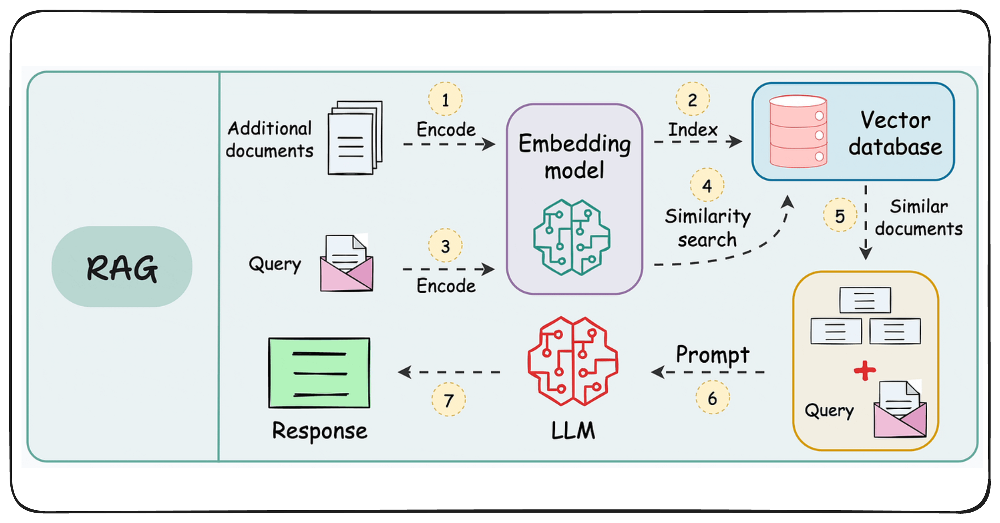

# Introduction to Retrieval-Augmented Generation (RAG)

---

## Why RAG Exists

Large language models are remarkably capable, but they come with inherent limitations that become apparent in real-world applications.

**Knowledge cutoff.** LLMs are trained on data up to a specific point in time. They have no awareness of events, publications, or changes that occurred after training. Ask a model about yesterday's news, and it simply cannot know.

**Hallucination.** Even when an LLM has encountered relevant information during training, it may still generate plausible-sounding but factually incorrect responses. This is especially problematic in domains where accuracy is non-negotiable—legal, medical, financial, or any enterprise context.

**Proprietary and sensitive content.** Organizations often need LLMs to reason over internal documents, customer data, or domain-specific knowledge that was never part of public training corpora. A vanilla LLM has no access to this information.

**Context window constraints.** While modern LLMs support increasingly large context windows, there are still practical limits. You cannot simply paste an entire knowledge base into a prompt and expect coherent, cost-effective results.

These limitations share a common thread: the model lacks access to the right information at inference time.

---

## What is RAG?

At its core, RAG follows a simple principle: **retrieve first, then generate**.

Instead of relying solely on what the model "remembers" from training, RAG systems fetch relevant information from an external knowledge source and provide it to the model as context. The model then generates a response grounded in that retrieved content.

Think of it this way: rather than asking someone to answer a question purely from memory, you hand them the relevant documents and ask them to answer based on what they just read.

**Retrieval-Augmented Generation (RAG)** is a framework introduced by [Lewis et al. (2020)](https://arxiv.org/pdf/2005.11401) that combines a retrieval mechanism with a generative language model. The retriever identifies relevant passages from a corpus, and the generator produces a response conditioned on both the original query and the retrieved context.

This approach does not require modifying the model's weights. The LLM remains unchanged; what changes is the input it receives.

---

## Where RAG Fits in Modern LLM Systems

When building applications with LLMs, you typically have three broad options for incorporating domain-specific knowledge:

**Prompt-only approaches.** You include all necessary context directly in the prompt. This works for small, static contexts but does not scale. You are limited by the context window, and you pay for every token on every request.

**Fine-tuning.** You retrain or adapt the model on domain-specific data. This can embed knowledge into the model's parameters, but it is costly, requires ML infrastructure, and must be repeated when data changes. Repeated fine-tuning can also lead to model shift—unintended changes in the model's behavior over time.

**Retrieval-Augmented Generation.** You retrieve relevant content dynamically at inference time and inject it into the prompt. The model is not modified. The knowledge source can be updated independently of the model, making this approach well-suited for data that changes frequently.

RAG occupies a practical middle ground. It avoids the rigidity of prompt-only approaches and the operational overhead of fine-tuning. For many production use cases—chatbots over documentation, question answering over enterprise data, assistants grounded in current information—RAG is the default starting point.

---

## Use Case: Question Answering Over Hugging Face Documentation

Technical documentation is a perfect candidate for RAG. It is extensive, frequently updated, and users often need precise answers to specific questions rather than general summaries.

In this notebook, we will build a RAG system over the [Hugging Face documentation dataset](https://huggingface.co/datasets/m-ric/huggingface_doc). This dataset contains documentation pages covering Transformers, Diffusers, Datasets, and other libraries in the Hugging Face ecosystem.

Our RAG system will allow users to ask natural language questions—such as "How do I load a pretrained model?" or "What is gradient checkpointing?"—and receive accurate, grounded answers drawn directly from the official documentation.

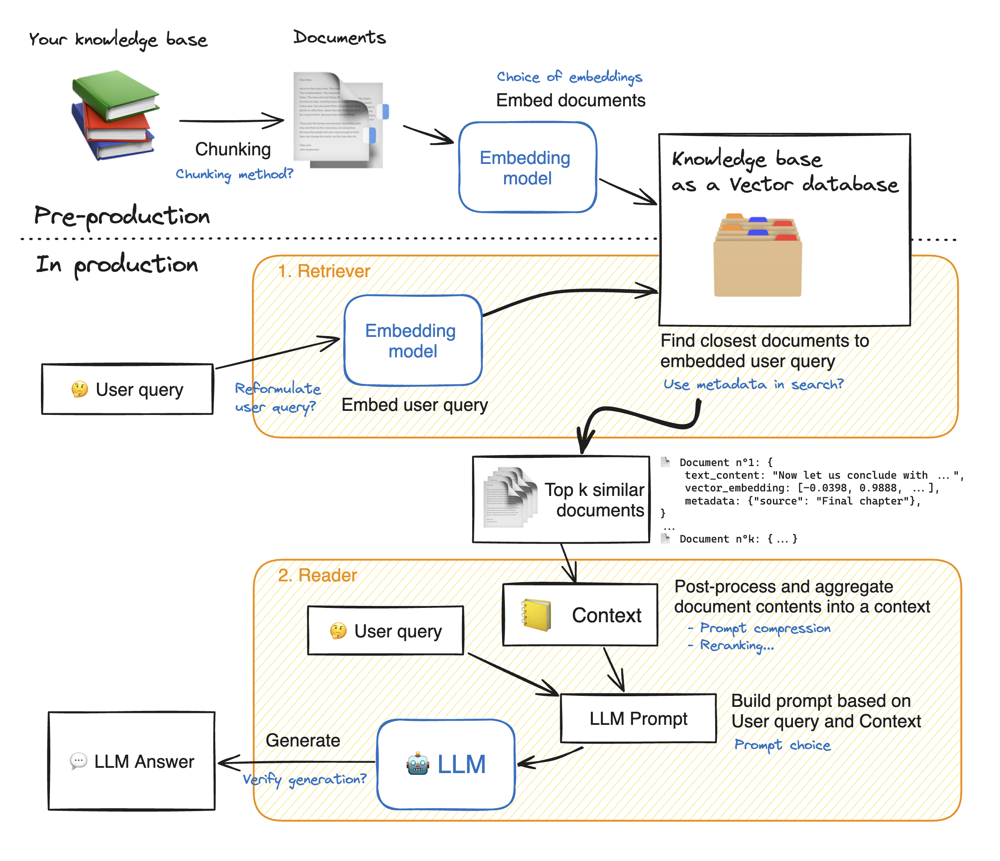

[Reference](https://huggingface.co/learn/cookbook/en/advanced_rag)

## Loading the Dataset

Before building any RAG pipeline, we need to understand the data we are working with. The [Hugging Face documentation dataset](https://huggingface.co/datasets/m-ric/huggingface_doc) contains text extracted from official documentation pages across multiple Hugging Face libraries.

Loading and inspecting the dataset first allows us to identify which fields contain the text we want to retrieve, understand the structure and size of the corpus, and make informed decisions about preprocessing steps that come later.

In [1]:
from datasets import load_dataset

# Load the Hugging Face documentation dataset
dataset = load_dataset("m-ric/huggingface_doc", split="train")

print(f"Number of documents: {len(dataset)}")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


README.md:   0%|          | 0.00/21.0 [00:00<?, ?B/s]

huggingface_doc.csv:   0%|          | 0.00/22.0M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/2647 [00:00<?, ? examples/s]

Number of documents: 2647


In [2]:
# Inspect the dataset structure
print("Dataset features:")
print(dataset.features)

Dataset features:
{'text': Value('string'), 'source': Value('string')}


In [3]:
# Look at a single example to understand the content
example = dataset[0]

print("Sample document:")
print("-" * 50)
for key, value in example.items():
    # Truncate long text for display
    if isinstance(value, str) and len(value) > 500:
        print(f"{key}: {value[:500]}...")
    else:
        print(f"{key}: {value}")

Sample document:
--------------------------------------------------
text:  Create an Endpoint

After your first login, you will be directed to the [Endpoint creation page](https://ui.endpoints.huggingface.co/new). As an example, this guide will go through the steps to deploy [distilbert-base-uncased-finetuned-sst-2-english](https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english) for text classification. 

## 1. Enter the Hugging Face Repository ID and your desired endpoint name:

<img src="https://raw.githubusercontent.com/huggingface/hf-endpoints-docu...
source: huggingface/hf-endpoints-documentation/blob/main/docs/source/guides/create_endpoint.mdx


#### Reference - https://huggingface.co/docs/inference-endpoints/en/guides/create_endpoint

In [4]:
# Check the text field we will use for retrieval
# This is the main content that will be indexed and searched
print("First document text (truncated):")
print("-" * 50)
print(example["text"][:1000] if len(example["text"]) > 1000 else example["text"])

First document text (truncated):
--------------------------------------------------
 Create an Endpoint

After your first login, you will be directed to the [Endpoint creation page](https://ui.endpoints.huggingface.co/new). As an example, this guide will go through the steps to deploy [distilbert-base-uncased-finetuned-sst-2-english](https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english) for text classification. 

## 1. Enter the Hugging Face Repository ID and your desired endpoint name:

<img src="https://raw.githubusercontent.com/huggingface/hf-endpoints-documentation/main/assets/1_repository.png" alt="select repository" />

## 2. Select your Cloud Provider and region. Initially, only AWS will be available as a Cloud Provider with the `us-east-1` and `eu-west-1` regions. We will add Azure soon, and if you need to test Endpoints with other Cloud Providers or regions, please let us know.

<img src="https://raw.githubusercontent.com/huggingface/hf-endpoints-documentatio

The `text` field contains the documentation content we will use for retrieval. Each document represents a page or section from Hugging Face's official documentation.

## Introducing the LLM for Generation

Before we connect retrieval to generation, we need to establish a working connection to our language model. This section demonstrates a basic inference call using OpenAI's API.

At this stage, the LLM has no access to external knowledge—it responds based solely on its training data. This baseline will help illustrate the difference once we augment prompts with retrieved context.


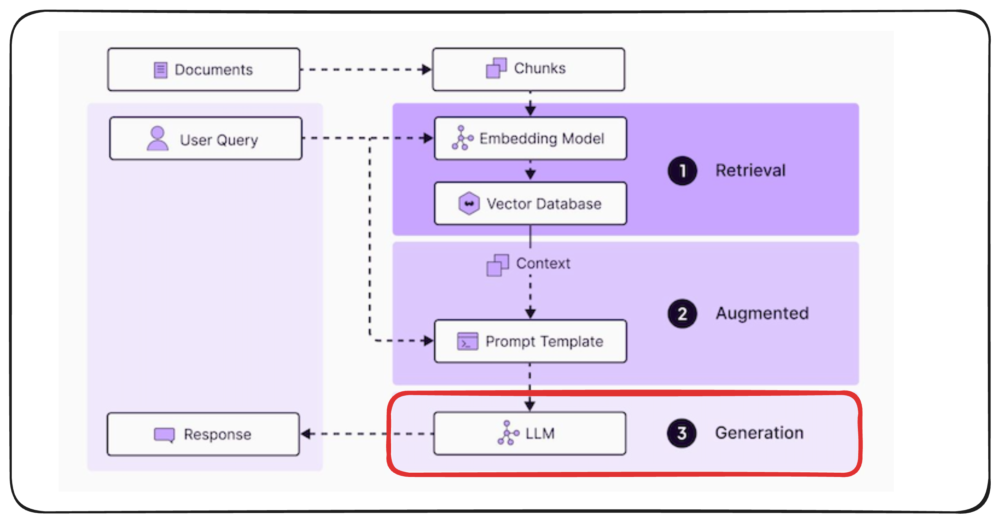

In [5]:
import os
import getpass

# Securely input your OpenAI API key
os.environ["OPENAI_API_KEY"] = getpass.getpass("Enter your OpenAI API key: ")

Enter your OpenAI API key: ··········


In [6]:
from openai import OpenAI

# Initialize the OpenAI client
open_ai_client = OpenAI()

In [7]:
# Basic inference example (no retrieval, no augmentation)
response = open_ai_client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {"role": "user", "content": "What is the capital of France?"}
    ]
)

print(response.choices[0].message.content)

The capital of France is Paris.


This confirms that the LLM is accessible and responding. The model answers from its parametric knowledge alone. In the following sections, we will enhance this by injecting retrieved context into the prompt.

## Chunking: Preparing Documents for Retrieval

Before documents can be embedded and searched, they must be split into smaller pieces called **chunks**. This preprocessing step is fundamental to RAG performance.

### What is Chunking?

Chunking is the process of breaking down large documents into smaller, manageable segments. LLMs have a limited context window, meaning they can only focus on a certain amount of text at once. If there is too much text within the context window, important details get lost, resulting in incomplete or inaccurate answers.

Chunking solves this by creating smaller, focused pieces of content that an LLM can use to answer queries without getting lost in irrelevant information.

### Why Chunking Matters for RAG

The size, content, and semantic boundaries of each chunk directly influence retrieval performance. When a RAG system performs poorly, the issue is often not the retriever—it is the chunks. Even a perfect retrieval system fails if it searches over poorly prepared data.

**Chunks that are too large** often mix multiple ideas together. Subtopics can get lost or muddled, creating a noisy, "averaged" embedding that does not clearly represent any single topic. This makes it difficult for vector search to find all the relevant context.

**Chunks that are too small** fail a simple test: if a chunk does not make sense when read alone, it will not make sense to the LLM either. Imagine reading a single sentence from the middle of a research paper—even humans would struggle to understand what is happening without more context.

**Chunks that are too large for the LLM** create a different problem. LLM performance degrades with longer context inputs due to attention dilution and the "lost in the middle" effect, where models have trouble accessing information buried in the middle of long contexts.

### The Goal

You want to preserve the author's "train of thought" while creating chunks that are small enough for precise retrieval but complete enough to give the LLM full context. Getting this balance right improves retrieval quality, manages the LLM's context window effectively, reduces hallucinations, and enhances efficiency.

---

For this tutorial, we will use **Chonkie**, a lightweight library focused specifically on text chunking. We will apply different chunking strategies and visualize the results to understand when to use each approach.

---

## Installing Required Libraries

In [8]:
!pip install -q chonkie[viz] rich

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 55.7 MB/s eta 0:00:00


---

## Choosing a Teaching Example

For this demonstration, we'll use a simple blog post about productivity. This example is ideal for learning chunking because:
- It has **clear paragraphs** with distinct topics
- It contains **natural section breaks** (introduction, tips, conclusion)
- It uses **everyday language** that's easy to follow
- It's long enough to demonstrate chunking but short enough to visualize completely

In [9]:
# A sample blog post about productivity
teaching_document = """
The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep work": professional activities performed in a state of distraction-free concentration that push your cognitive capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work helps you master complex skills faster. Learning difficult concepts requires sustained attention—something impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate? Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't. Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might discover that you're spending less time in deep work than you thought, or that certain days of the week are more conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep work a regular part of your routine rather than an occasional occurrence.
"""

print(f"Document length: {len(teaching_document)} characters")
print(f"Number of paragraphs: {teaching_document.count(chr(10) + chr(10))}")

Document length: 3219 characters
Number of paragraphs: 15


---

## Strategy 1: Fixed-Size Token Chunking

### What Problem Does This Solve?

When you need **predictable, uniform chunk sizes** for consistent processing and embedding generation. This is the simplest and most common approach.

### What to Look For in the Visualization

Pay attention to:
- **All chunks (except the last one) are exactly the same size** in terms of tokens
- **Chunks may split in the middle of sentences or paragraphs** (see the color changes mid-sentence)
- **No overlap between chunks** means context from one chunk doesn't carry over to the next

In [10]:
from chonkie import TokenChunker
from tokenizers import Tokenizer
from chonkie import Visualizer

# Initialize the tokenizer
# We're using GPT-2's tokenizer as a standard reference
tokenizer = Tokenizer.from_pretrained("gpt2")

# Create a fixed-size chunker
# chunk_size: Each chunk will have exactly 128 tokens (except possibly the last one)
# chunk_overlap: 0 means no overlap - each chunk is completely independent
fixed_size_chunker = TokenChunker(
    tokenizer=tokenizer,
    chunk_size=128,
    chunk_overlap=0
)

# Apply chunking to our teaching document
fixed_chunks = fixed_size_chunker.chunk(teaching_document)

print(f"Number of chunks created: {len(fixed_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in fixed_chunks]}")

# Visualize the chunks
# Each color represents a different chunk
# Notice how the colors change abruptly, sometimes mid-sentence
viz = Visualizer()
viz.print(fixed_chunks)

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Number of chunks created: 5
Chunk sizes (in tokens): [128, 128, 128, 128, 105]


The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively 
demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep
work": professional activities performed in a state of distraction-free concentration that push your cognitive 
capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When 
you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work 
helps you master complex skills faster. Learning difficult concepts requires sustained attention—something 
impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more 
than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate?
Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary 
browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly 
being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't.
Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning 
hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. 
As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour 
blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your 
workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and 
saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished 
tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work 
thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might 
discover that you're spending less time in deep work than you thought, or that certain days of the week are more 
conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max
out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep 
work a regular part of your routine rather than an occasional occurrence.

**What you should notice:**
- The text is divided into rigid, equal-sized blocks
- Some chunks start or end in the middle of sentences (the color boundaries don't align with sentence endings)
- If you asked about "time blocking," the answer might be split across multiple chunks

**When to use this approach:**
- When you need consistent chunk sizes for batch processing
- When computational efficiency is more important than semantic coherence
- As a baseline to compare against more sophisticated methods

---

## Strategy 2: Token Chunking with Overlap

### What Problem Does This Solve?

The previous approach had a critical flaw: important context could be split between chunks. **Overlap** solves this by allowing adjacent chunks to share some content, preserving context across boundaries.

### What to Look For in the Visualization

Pay attention to:
- **Chunks now share some text** (you'll see the same content repeated in adjacent colored blocks)
- **The overlap region** appears in multiple chunks, creating continuity
- **Sentence breaks are still ignored** but now there's a "buffer zone" between chunks

In [11]:
# Create a chunker with overlap
# chunk_size: Still 128 tokens per chunk
# chunk_overlap: 32 tokens (25% overlap) will be repeated in adjacent chunks
overlap_chunker = TokenChunker(
    tokenizer=tokenizer,
    chunk_size=128,
    chunk_overlap=32  # This is the key difference
)

# Apply chunking
overlap_chunks = overlap_chunker.chunk(teaching_document)

print(f"Number of chunks created: {len(overlap_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in overlap_chunks]}")

# Visualize the chunks with overlap
# Look for repeated text where colors transition - that's the overlap
viz.print(overlap_chunks)

Number of chunks created: 7
Chunk sizes (in tokens): [128, 128, 128, 128, 128, 128, 41]


The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively 
demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep
work": professional activities performed in a state of distraction-free concentration that push your cognitive 
capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When 
you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work 
helps you master complex skills faster. Learning difficult concepts requires sustained attention—something 
impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more 
than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate?
Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary 
browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly 
being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't.
Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning 
hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. 
As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour 
blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your 
workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and 
saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished 
tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work 
thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might 
discover that you're spending less time in deep work than you thought, or that certain days of the week are more 
conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max
out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep 
work a regular part of your routine rather than an occasional occurrence.

In [12]:
overlap_chunks[0]

Chunk(text='
The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep work": professional activities performed in a state of distraction-free concentration that push your cognitive capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep', token_count=128, start_index=0, end_index=661)

In [13]:
overlap_chunks[1]

Chunk(text=' to produce high-quality output in less time. When you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work helps you master complex skills faster. Learning difficult concepts requires sustained attention—something impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate? Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications', token_count=128, start_index=503, end_index=1228)

**What you should notice:**
- Where one chunk ends and the next begins, there's repeated text
- This repetition creates a "bridge" between chunks
- If a concept is split, at least part of it appears in both chunks
- The total storage required increases (you're storing some text multiple times)

**When to use this approach:**
- When preserving context across chunk boundaries is critical
- For Q&A systems where questions might relate to text near chunk boundaries
- When you can afford the extra storage for redundant information

**The tradeoff:** More overlap means better context preservation but increased storage and processing costs.

---

## Strategy 3: Semantic Chunking

### What Problem Does This Solve?

Both previous methods ignore the *meaning* of the text. **Semantic chunking** uses AI to understand the content and splits at natural topic boundaries, creating chunks that each focus on a coherent idea.

### What to Look For in the Visualization

Pay attention to:
- **Chunks now vary in size** (some are longer, some are shorter)
- **Splits happen at topic transitions** not just at arbitrary token counts
- **Each chunk contains a complete idea** (e.g., one chunk might be entirely about "Creating Your Deep Work Environment")

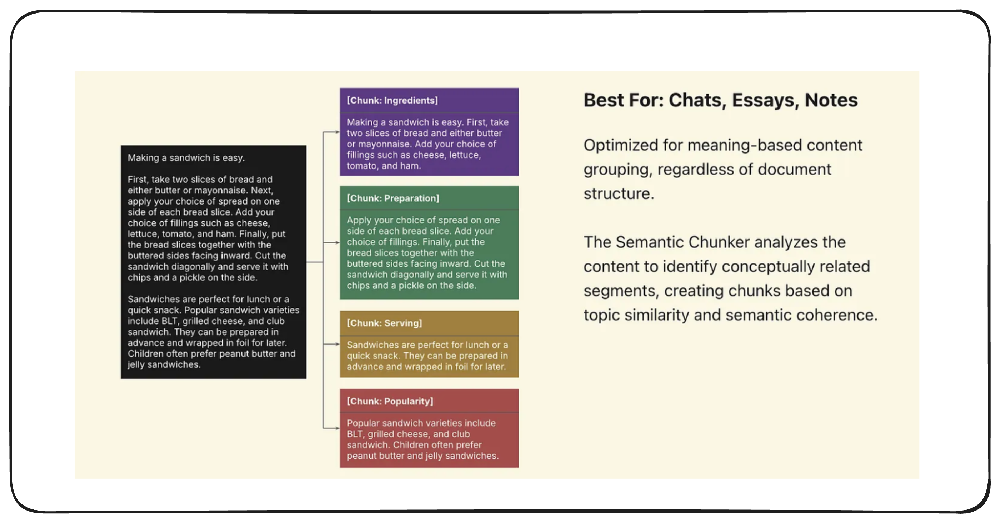

In [14]:
from chonkie import SemanticChunker

# Initialize semantic chunker
# This uses an embedding model to understand the meaning of sentences
semantic_chunker = SemanticChunker(
    embedding_model="minishlab/potion-base-32M",  # Lightweight model for understanding meaning
    threshold=0.7,                                 # How different topics must be to split (0-1)
    chunk_size=512,                                # Maximum size, but chunks can be smaller
    similarity_window=3                            # How many sentences to consider together
)

# Apply semantic chunking
semantic_chunks = semantic_chunker.chunk(teaching_document)

print(f"Number of chunks created: {len(semantic_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in semantic_chunks]}")

# Visualize semantic chunks
# Notice how chunk boundaries align better with topic changes
viz.print(semantic_chunks)

/usr/local/lib/python3.12/dist-packages/chonkie/embeddings/auto.py:95: UserWarning: Failed to load minishlab/potion-base-32M with Model2VecEmbeddings: model2vec is not available. Please install it via `pip install chonkie[model2vec]`
Falling back to loading default provider model.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/chonkie/embeddings/auto.py:103: UserWarning: Failed to load the default model for Model2VecEmbeddings: model2vec is not available. Please install it via `pip install chonkie[model2vec]`
Falling back to SentenceTransformerEmbeddings.
  warnings.warn(


modules.json:   0%|          | 0.00/278 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

./model.safetensors:   0%|          | 0.00/129M [00:00<?, ?B/s]

Number of chunks created: 11
Chunk sizes (in tokens): [84, 93, 15, 9, 8, 18, 88, 109, 52, 3, 109]


The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively 
demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep
work": professional activities performed in a state of distraction-free concentration that push your cognitive 
capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When 
you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work 
helps you master complex skills faster. Learning difficult concepts requires sustained attention—something 
impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more 
than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate?
Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary 
browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly 
being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't.
Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning 
hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. 
As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour 
blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your 
workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and 
saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished 
tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work 
thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might 
discover that you're spending less time in deep work than you thought, or that certain days of the week are more 
conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max
out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep 
work a regular part of your routine rather than an occasional occurrence.

**What you should notice:**
- Chunks are different sizes based on where topics naturally change
- The "Why Deep Work Matters" section might be one complete chunk
- "Creating Your Deep Work Environment" might be another complete chunk
- Each chunk makes sense when read independently

**When to use this approach:**
- When semantic coherence is more important than uniform size
- For documents with clear section structures (like this blog post)
- When you want each chunk to represent a single complete idea
- When retrieval accuracy is more important than processing efficiency

**Best for:** Chats, essays, notes, blog posts—content where meaning-based grouping matters more than document structure.

**The tradeoff:** Requires embedding model inference (slower) but produces more meaningful chunks.

---

## Strategy 4: Recursive Chunking

### What Problem Does This Solve?

When your documents have **explicit structure** (headers, sections, subsections), you want to preserve that hierarchy. **Recursive chunking** respects the document's organizational structure, maintaining the relationship between sections and subsections.

### What to Look For in the Visualization

Pay attention to:
- **Chunks align with document structure** (sections, subsections)
- **Hierarchical relationships are preserved** (you know which subsection belongs to which section)
- **Different structural elements are treated appropriately** (headers stay with their content)

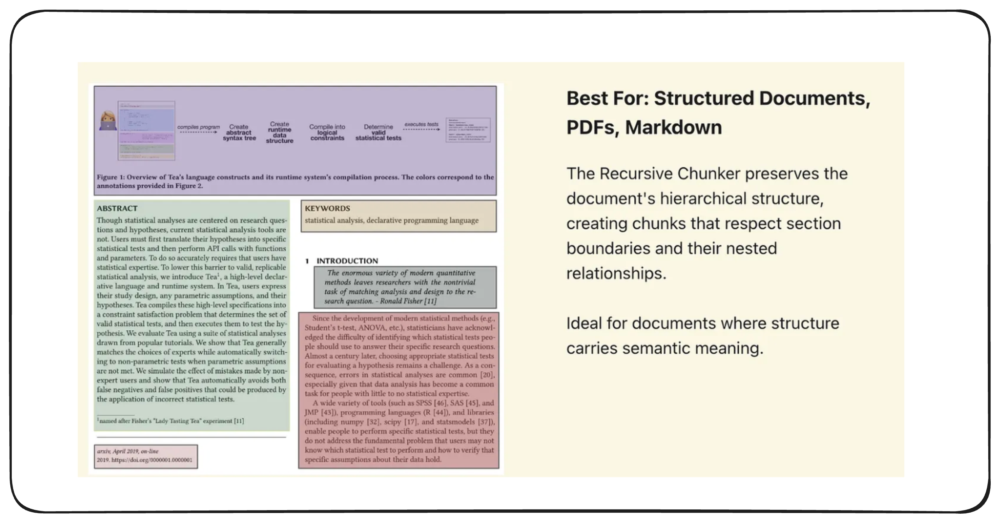

In [15]:
from chonkie import RecursiveChunker

# For documents with Markdown structure (headers, sections)
# This example assumes our document has been formatted with headers
markdown_document = """
# The Art of Deep Work: A Guide to Productivity\n
In today's world of constant notifications and endless distractions...\n\n

## Why Deep Work Matters\n
Deep work is valuable for several reasons...\n\n

## Creating Your Deep Work Environment\n
The first step in cultivating deep work...\n\n

### Physical Setup\n
Consider your physical setup: Is your desk organized?...\n\n

### Digital Distractions\n
Digital distractions are equally important to address...\n\n

## Time Blocking for Deep Work\n
Scheduling specific blocks of time for deep work is crucial...\n\n
"""

# Initialize recursive chunker
recursive_chunker = RecursiveChunker(
    tokenizer=tokenizer,
    chunk_size=15,
    #chunk_overlap=32,

)

# Apply recursive chunking
recursive_chunks = recursive_chunker.chunk(markdown_document)

print(f"Number of chunks created: {len(recursive_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in recursive_chunks]}")

# Visualize recursive chunks
viz.print(recursive_chunks)

Number of chunks created: 13
Chunk sizes (in tokens): [14, 13, 8, 10, 9, 10, 12, 7, 7, 10, 10, 15, 1]


# The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions...



## Why Deep Work Matters

Deep work is valuable for several reasons...



## Creating Your Deep Work Environment

The first step in cultivating deep work...



### Physical Setup

Consider your physical setup: Is your desk organized?...



### Digital Distractions

Digital distractions are equally important to address...



## Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial...

**What you should notice:**
- Sections with headers stay together as complete units (when possible)
- Subsections are nested properly within their parent sections
- The document's hierarchical structure is visible in the chunks
- Related content under the same header is grouped together

**When to use this approach:**
- When working with structured documents (Markdown, HTML, XML)
- For documentation, technical papers, or reports with clear sections
- When the document's organization carries semantic meaning
- When you need to preserve parent-child relationships between sections

**Best for:** Structured documents, PDFs with clear sections, Markdown files, technical documentation.

**The tradeoff:** Requires documents with explicit structure; won't work well on free-flowing text.

---

## Strategy 5: Late Chunking

### What Problem Does This Solve?

Traditional chunking happens before embedding, which means each chunk's embedding is computed in isolation. **Late chunking** embeds the *entire document first*, then segments it afterward. This preserves the full semantic context and captures cross-document relationships.

### What to Look For in the Visualization

Pay attention to:
- **Large, contextually-aware chunks** (the embedding knows about surrounding content)
- **Cross-references are preserved** (mentions of earlier concepts retain their context)
- **Document-level coherence** is maintained even after splitting

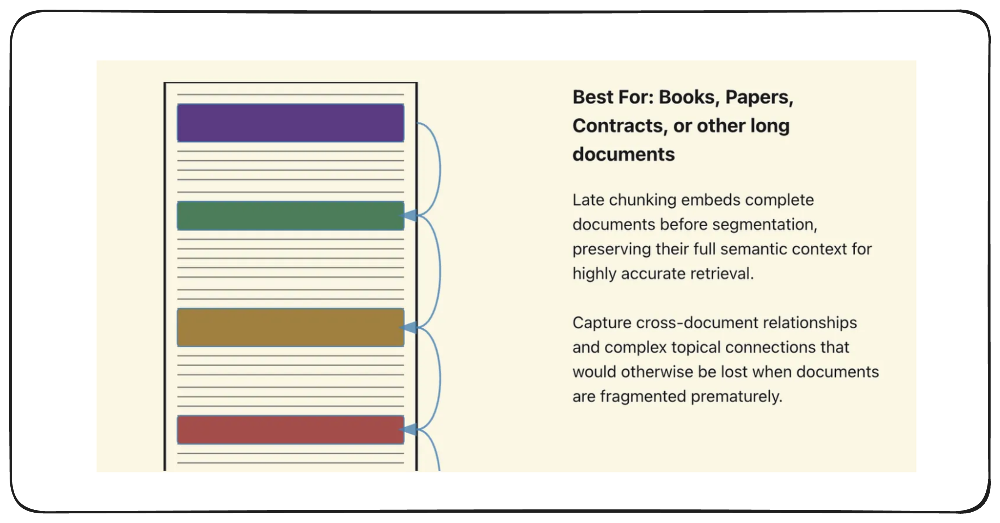

In [16]:
from chonkie import LateChunker

# Initialize late chunker
# This embeds the full document before chunking
late_chunker = LateChunker(
    embedding_model="minishlab/potion-base-32M",
    #tokenizer=tokenizer,
    chunk_size=512,

)

# Apply late chunking
# Note: This processes the entire document at once before splitting
late_chunks = late_chunker.chunk(teaching_document)

print(f"Number of chunks created: {len(late_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in late_chunks]}")

# Visualize late chunks
# These chunks carry full document context in their embeddings
viz.print(late_chunks)

Number of chunks created: 2
Chunk sizes (in tokens): [1, 1]


The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively 
demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep
work": professional activities performed in a state of distraction-free concentration that push your cognitive 
capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When 
you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work 
helps you master complex skills faster. Learning difficult concepts requires sustained attention—something 
impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more 
than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate?
Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary 
browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly 
being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't.
Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning 
hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. 
As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour 
blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your 
workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and 
saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished 
tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work 
thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might 
discover that you're spending less time in deep work than you thought, or that certain days of the week are more 
conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max
out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep 
work a regular part of your routine rather than an occasional occurrence.

**What you should notice:**
- Chunks may look similar in size to other methods
- But their *embeddings* are fundamentally different—they understand document-wide context
- References to earlier sections are understood in context
- The document's overall theme influences how each chunk is embedded

**When to use this approach:**
- For long documents where context matters (books, research papers, contracts)
- When cross-document references are important
- When you need to capture the document's overall theme
- For legal or technical documents where understanding the whole is crucial

**Best for:** Books, papers, contracts, legal documents, comprehensive guides.

**The tradeoff:** Computationally expensive (must embed entire document); requires models with large context windows; but provides superior semantic understanding.

---

## Strategy 6: LLM-Based Agentic Chunking

### What Problem Does This Solve?

Sometimes even semantic and recursive chunking aren't smart enough. **LLM-based chunking** uses a language model to make intelligent decisions about where to split, understanding context, intent, and document structure at a deeper level.

### What to Look For in the Visualization

Pay attention to:
- **Highly variable chunk sizes** (the LLM decides what makes sense)
- **Splits at the most logical boundaries** (section headings, major topic transitions)
- **Each chunk is a "complete thought"** that stands alone

In [17]:
from chonkie import SlumberChunker
from chonkie.genie import OpenAIGenie
import os
import getpass

# Set up API key (if not already set)
if "OPENAI_API_KEY" not in os.environ:
    os.environ["OPENAI_API_KEY"] = getpass.getpass("Enter your OpenAI API key: ")

# Initialize the LLM-based chunker
# This uses GPT-4o-mini to make intelligent splitting decisions
genie = OpenAIGenie(model="gpt-4o-mini")

llm_chunker = SlumberChunker(
    genie=genie,
    tokenizer="gpt2",
    chunk_size=512,                # Maximum size, but LLM can choose smaller
    candidate_size=128,            # Text window the LLM analyzes for split decisions
    min_characters_per_chunk=50   # Minimum viable chunk size
)

# Apply LLM-based chunking
# Note: This makes API calls and will take longer than previous methods
llm_chunks = llm_chunker.chunk(teaching_document)

print(f"Number of chunks created: {len(llm_chunks)}")
print(f"Chunk sizes (in tokens): {[chunk.token_count for chunk in llm_chunks]}")

# Visualize LLM-based chunks
# These should align very closely with the logical structure of the document
viz.print(llm_chunks)

🦛 choooooooooooooooooooonk 100% • 10/10 splits processed [00:02<00:00,  3.99split/s] 🌱

Number of chunks created: 2
Chunk sizes (in tokens): [500, 117]


The Art of Deep Work: A Guide to Productivity

In today's world of constant notifications and endless distractions, the ability to focus deeply on cognitively 
demanding tasks has become increasingly rare—and increasingly valuable. This is what author Cal Newport calls "deep
work": professional activities performed in a state of distraction-free concentration that push your cognitive 
capabilities to their limit.

Why Deep Work Matters

Deep work is valuable for several reasons. First, it allows you to produce high-quality output in less time. When 
you're fully concentrated on a single task, you work more efficiently and make fewer mistakes. Second, deep work 
helps you master complex skills faster. Learning difficult concepts requires sustained attention—something 
impossible to achieve when constantly switching between tasks.

Creating Your Deep Work Environment

The first step in cultivating deep work is designing an environment that supports concentration. This means more 
than just finding a quiet space. Consider your physical setup: Is your desk organized? Is the lighting appropriate?
Do you have everything you need within reach?

Digital distractions are equally important to address. Turn off notifications on your devices. Close unnecessary 
browser tabs. Use website blockers if needed. The goal is to create a space where your attention isn't constantly 
being pulled away from the task at hand.

Time Blocking for Deep Work

Scheduling specific blocks of time for deep work is crucial. Don't wait for free time to magically appear—it won't.
Instead, treat deep work sessions as important appointments with yourself. Many people find that early morning 
hours work best, when their mental energy is highest and distractions are minimal.

Start with manageable blocks. If you're new to deep work, even 60-90 minutes of focused time can feel challenging. 
As you build your concentration muscles, gradually extend these sessions. Some professionals work up to four-hour 
blocks of uninterrupted deep work.

The Shutdown Ritual

Just as important as starting deep work is knowing when to stop. Develop a shutdown ritual to mark the end of your 
workday. This might include reviewing your task list for tomorrow, closing all work-related browser tabs, and 
saying a specific phrase like "shutdown complete."

This ritual serves multiple purposes. It helps you mentally disconnect from work, reduces anxiety about unfinished 
tasks, and ensures you've captured anything important before stepping away. Without this clear boundary, work 
thoughts tend to linger into your evening, preventing true rest and recovery.

Measuring Your Progress

Track your deep work hours each week. This simple metric provides valuable feedback on your habits. You might 
discover that you're spending less time in deep work than you thought, or that certain days of the week are more 
conducive to concentration than others.

Remember, the goal isn't to spend every waking hour in deep work. Even the most focused professionals typically max
out at four to five hours of truly deep work per day. What matters is consistency and intentionality—making deep 
work a regular part of your routine rather than an occasional occurrence.

**What you should notice:**
- Chunks likely align perfectly with the blog post's sections
- The introduction might be one chunk, "Why Deep Work Matters" another, and so on
- Each chunk is a self-contained unit that makes complete sense alone
- The LLM might even recognize that "The Shutdown Ritual" is tightly coupled with "Time Blocking"

**When to use this approach:**
- When chunk quality is paramount and cost/speed are secondary concerns
- For complex documents where structure and intent matter
- When you need human-level judgment about information boundaries
- For high-value use cases (legal documents, medical records, critical research)

**The tradeoff:** Much slower and more expensive (requires LLM API calls), but produces the highest quality chunks.

---

## Comparing All Strategies: A Quick Reference

| Strategy | What It Does | Best For | Speed | Cost |
|----------|--------------|----------|-------|------|
| **Fixed-Size** | Splits at exact token counts | Consistent processing, baselines | ⚡⚡⚡ | 💰 |
| **Fixed with Overlap** | Fixed size + shared context | General-purpose RAG | ⚡⚡⚡ | 💰💰 |
| **Semantic** | Splits at topic changes | Essays, chats, notes | ⚡⚡ | 💰💰 |
| **Recursive** | Preserves document structure | Markdown, PDFs, documentation | ⚡⚡⚡ | 💰 |
| **Late Chunking** | Embeds full document first | Books, papers, contracts | ⚡ | 💰💰💰 |
| **LLM-Based** | AI-powered intelligent splitting | High-value documents | ⚡ | 💰💰💰💰 |

#### Reference
[Reference 1](https://weaviate.io/blog/chunking-strategies-for-rag)

---

## Key Takeaways

1. **No universal "best" method exists** - your choice depends on document type, query patterns, and constraints

2. **Most teams should start with token chunking + overlap** - it's simple, fast, and works well for 80% of cases

3. **Semantic chunking is the sweet spot for unstructured text** - better quality than fixed-size, cheaper than LLM-based

4. **Use recursive chunking for structured documents** - Markdown, PDFs, and documentation benefit enormously

5. **Late chunking is underrated** - for long documents where context matters, the extra cost is worth it

6. **Reserve LLM-based chunking for high-value documents** - legal contracts, medical records, critical research

7. **Always visualize before scaling** - Chonkie's visualizer catches problems immediately

8. **Chunk size matters more than chunking method** for most applications - experiment with 128, 256, 512 tokens

9. **Overlap is almost always worth it** - even 20% overlap dramatically improves retrieval quality

10. **Measure actual retrieval performance** - the "best" chunking strategy is the one that works for your specific use case

---

## What's Next?

Now that you understand chunking strategies, the next step is to:
1. **Embed these chunks** using a sentence transformer or embedding model
2. **Store them in a vector database** (like FAISS, Pinecone, or Weaviate)
3. **Implement retrieval** to fetch relevant chunks for a given query
4. **Pass retrieved chunks to an LLM** to generate grounded answers

Let's continue building the RAG pipeline...

In [18]:
!pip install -q sentence-transformers

In [19]:
from sentence_transformers import SentenceTransformer

# Load a pre-trained embedding model
# all-MiniLM-L6-v2 is lightweight and effective for general-purpose semantic search
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")

print(f"Model loaded: all-MiniLM-L6-v2")
print(f"Embedding dimension: {embedding_model.get_sentence_embedding_dimension()}")

# Create all_chunks by chunking all documents in the dataset
# Using TokenChunker for the full dataset
from chonkie import TokenChunker
from tokenizers import Tokenizer

# Initialize tokenizer and chunker
tokenizer = Tokenizer.from_pretrained("gpt2")
chunker = TokenChunker(
    tokenizer=tokenizer,
    chunk_size=256,
    chunk_overlap=32
)

# Chunk all documents in the dataset
all_chunks = []
for doc in dataset:
    doc_chunks = chunker.chunk(doc["text"])
    all_chunks.extend(doc_chunks)

print(f"Total chunks created from dataset: {len(all_chunks)}")

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Model loaded: all-MiniLM-L6-v2
Embedding dimension: 384
Total chunks created from dataset: 33769


In [20]:
all_chunks[0]

Chunk(text=' Create an Endpoint

After your first login, you will be directed to the [Endpoint creation page](https://ui.endpoints.huggingface.co/new). As an example, this guide will go through the steps to deploy [distilbert-base-uncased-finetuned-sst-2-english](https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english) for text classification. 

## 1. Enter the Hugging Face Repository ID and your desired endpoint name:

<img src="https://raw.githubusercontent.com/huggingface/hf-endpoints-documentation/main/assets/1_repository.png" alt="select repository" />

## 2. Select your Cloud Provider and region. Initially, only AWS will be available as a Cloud Provider with the `us-east-1` and `eu-west-1` regions. We will add Azure soon, and if you need to test Endpoints with other Cloud Providers or regions, please let us know.

<img src="https://raw.githubusercontent.com', token_count=256, start_index=0, end_index=878)

In [21]:
# Extract text from chunks created in the previous section
chunk_texts = [chunk.text for chunk in all_chunks]

print(f"Number of chunks to embed: {len(chunk_texts)}")
print(f"Sample chunk text (truncated): {chunk_texts[0][:200]}...")

Number of chunks to embed: 33769
Sample chunk text (truncated):  Create an Endpoint

After your first login, you will be directed to the [Endpoint creation page](https://ui.endpoints.huggingface.co/new). As an example, this guide will go through the steps to deplo...


In [22]:
import numpy as np
np.array(chunk_texts).shape

(33769,)

In [23]:
# Generate embeddings for all chunks
embeddings = embedding_model.encode(chunk_texts[0:200])

print(f"Embeddings shape: {embeddings.shape}")
print(f"Each chunk is represented by a {embeddings.shape[1]}-dimensional vector")

Embeddings shape: (200, 384)
Each chunk is represented by a 384-dimensional vector


In [24]:
# Embed a sample query using the same model
sample_query = "How do I load a pretrained model?"
query_embedding = embedding_model.encode(sample_query)

print(f"Query: '{sample_query}'")
print(f"Query embedding shape: {query_embedding.shape}")
print(f"Query embedding (first 10 values): {query_embedding[:10]}")

Query: 'How do I load a pretrained model?'
Query embedding shape: (384,)
Query embedding (first 10 values): [-0.02789504 -0.04522779  0.00200946  0.0494822  -0.01643985  0.08898938
 -0.08490765  0.04477692 -0.05589382 -0.04211756]


## **Vector Databases: Storage and Retrieval**

After generating embeddings for our text chunks, we need a specialized database to store and efficiently search through these vectors. This section introduces **vector databases** and demonstrates how to implement semantic search.

---

### **Why Traditional Databases Don't Suffice**

Traditional databases like PostgreSQL or MySQL are optimized for exact-match queries on structured data—names, dates, prices, categories. They excel at queries like "find all users who signed up in December" but struggle with semantic similarity searches across high-dimensional vectors.

Vector databases, in contrast, are purpose-built to handle a fundamentally different problem: **finding vectors most similar to a query vector** across potentially billions of high-dimensional points.

---

### **Installing ChromaDB**

ChromaDB is an open-source vector database that's lightweight, easy to use, and perfect for learning and prototyping RAG systems.

In [25]:
!pip install -q chromadb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.7/21.7 MB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 30.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 101.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 128.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.6/132.6 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.0/220.0 kB 27.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.6/71.6 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128

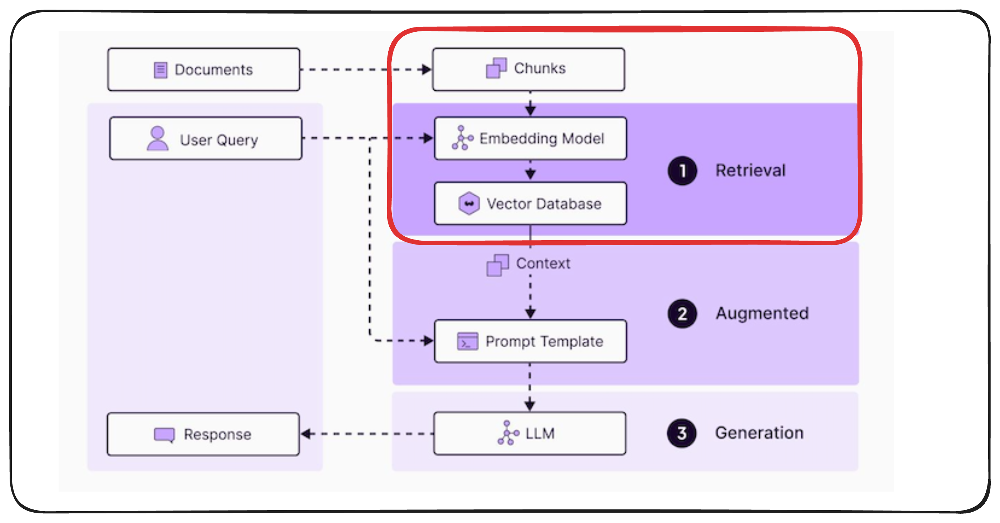

---

### **Creating a Vector Database**

A vector database stores two key pieces of information together:
1. **The original text chunk** (the actual words from your document)
2. **The embedding vector** (the numerical representation)

Let's create a ChromaDB collection and populate it with our document chunks and their embeddings.

In [27]:
import chromadb
from chromadb.utils import embedding_functions

# Create a persistent ChromaDB client
client = chromadb.Client()

# Create a collection to store our documents
# Collections are like tables in traditional databases
collection = client.create_collection(
    name="huggingface_docs",
    metadata={"description": "Hugging Face documentation chunks"}
)

---

### **Adding Documents to the Collection**

Now we'll add our chunked documents to the collection. ChromaDB will automatically handle the embedding generation if we don't provide embeddings explicitly, but since we've already generated embeddings, we'll use those.

In [28]:
# Prepare documents and embeddings for insertion
# We'll use a subset for this demonstration
num_docs_to_add = min(200, len(chunk_texts))

# ChromaDB requires unique IDs for each document
ids = [f"doc_{i}" for i in range(num_docs_to_add)]

# Add documents with their embeddings to the collection
collection.add(
    ids=ids,
    documents=chunk_texts[:num_docs_to_add], #Value -> Actual doc chunks
    embeddings=embeddings[:num_docs_to_add].tolist() #Key/Index -> Embeddings of doc chunks
)

print(f"Added {num_docs_to_add} documents to the collection")
print(f"Collection now contains {collection.count()} documents")

Added 200 documents to the collection
Collection now contains 200 documents


---

### **Semantic Search: Querying the Vector Database**

The power of vector databases lies in semantic search—finding documents based on meaning rather than exact keyword matches. Let's see this in action.

In [29]:
help(collection.query)

Help on method query in module chromadb.api.models.Collection:

query(query_embeddings: Union[numpy.ndarray[Any, numpy.dtype[Union[numpy.int32, numpy.float32]]], List[numpy.ndarray[Any, numpy.dtype[Union[numpy.int32, numpy.float32]]]], Sequence[float], Sequence[int], List[Union[Sequence[float], Sequence[int]]], NoneType] = None, query_texts: Union[str, List[str], NoneType] = None, query_images: Union[numpy.ndarray[Any, numpy.dtype[Union[numpy.uint64, numpy.int64, numpy.float64]]], List[numpy.ndarray[Any, numpy.dtype[Union[numpy.uint64, numpy.int64, numpy.float64]]]], NoneType] = None, query_uris: Union[str, List[str], NoneType] = None, ids: Union[str, List[str], NoneType] = None, n_results: int = 10, where: Optional[Dict[Union[str, Literal['$and'], Literal['$or']], Union[str, int, float, bool, Dict[Union[Literal['$gt'], Literal['$gte'], Literal['$lt'], Literal['$lte'], Literal['$ne'], Literal['$eq'], Literal['$and'], Literal['$or']], Union[str, int, float, bool]], Dict[Union[Literal['$

In [30]:
# Query the collection
user_query = "How do I load a pretrained model?"

# Perform similarity search
# ChromaDB will embed the query using the same method and find closest matches
results = collection.query(
    query_texts=[user_query],
    n_results=3  # Return top 3 most similar chunks
)

print(f"Query: '{user_query}'\n")
print("="*80)
print("Most Relevant Results:\n")

for i, (doc, distance) in enumerate(zip(results['documents'][0], results['distances'][0]), 1):
    print(f"Result {i} (Distance: {distance:.4f}):")
    print(f"{doc[:300]}...")  # Print first 300 characters
    print("-"*80)

/root/.cache/chroma/onnx_models/all-MiniLM-L6-v2/onnx.tar.gz: 100%|██████████| 79.3M/79.3M [00:06<00:00, 12.6MiB/s]


Query: 'How do I load a pretrained model?'

Most Relevant Results:

Result 1 (Distance: 0.9925):
 SE-ResNet

**SE ResNet** is a variant of a [ResNet](https://www.paperswithcode.com/method/resnet) that employs [squeeze-and-excitation blocks](https://paperswithcode.com/method/squeeze-and-excitation-block) to enable the network to perform dynamic channel-wise feature recalibration.

## How do I us...
--------------------------------------------------------------------------------
Result 2 (Distance: 1.1059):
>
  <img src="assets/33_large_language_models/02_t0.png">
</kbd>

You can try T0 [here](https://huggingface.co/bigscience/T0pp). This is the kind of research we need more of!

### Fine-Tune Models

If you need to specialize a model, there should be very few reasons to train it from scratch. Instead,...
--------------------------------------------------------------------------------
Result 3 (Distance: 1.1078):

  --load_best_model_at_end \
  --metric_for_best_model "eval_f1" \
  --pus

In [31]:
results['documents'][0][0]

' SE-ResNet\n\n**SE ResNet** is a variant of a [ResNet](https://www.paperswithcode.com/method/resnet) that employs [squeeze-and-excitation blocks](https://paperswithcode.com/method/squeeze-and-excitation-block) to enable the network to perform dynamic channel-wise feature recalibration.\n\n## How do I use this model on an image?\n\nTo load a pretrained model:\n\n```py\n>>> import timm\n>>> model = timm.create_model(\'seresnet152d\', pretrained=True)\n>>> model.eval()\n```\n\nTo load and preprocess the image:\n\n```py \n>>> import urllib\n>>> from PIL import Image\n>>> from timm.data import resolve_data_config\n>>> from timm.data.transforms_factory import create_transform\n\n>>> config = resolve_data_config({}, model=model)\n>>> transform = create_transform(**config)\n\n>>> url, filename = ("https://github.com/pytorch/hub/raw/master'

In [32]:
results['documents'][0][1]

'>\n  <img src="assets/33_large_language_models/02_t0.png">\n</kbd>\n\nYou can try T0 [here](https://huggingface.co/bigscience/T0pp). This is the kind of research we need more of!\n\n### Fine-Tune Models\n\nIf you need to specialize a model, there should be very few reasons to train it from scratch. Instead, you should fine-tune it, that is to say train it only for a few epochs on your own data. If you\'re short on data, maybe of one these [datasets](https://huggingface.co/datasets) can get you started.\n\nYou guessed it, that\'s another way to do transfer learning, and it\'ll help you save on everything!\n \n* Less data to collect, store, clean and annotate,\n* Faster experiments and iterations,\n* Fewer resources required in production.\n\nIn other words: save time, save money, save hardware resources, save the world! \n\nIf you need a tutorial, the Hugging Face [course](https://huggingface'

**What's happening here:**
1. ChromaDB converts your query text into an embedding vector using the same embedding model
2. It calculates the similarity (using cosine similarity or dot product) between the query vector and all stored document vectors
3. It returns the top N most similar chunks

The "distance" metric indicates how close the query is to each result—lower values mean higher similarity.

---

### **Understanding Metadata: Adding Structure to Semantic Search**

Beyond just text and embeddings, we can attach **metadata** to each chunk—structured information like source document, section title, timestamp, or any other relevant attributes.

In [33]:
# Let's recreate our collection with metadata
client.delete_collection(name="huggingface_docs")

collection = client.create_collection(
    name="huggingface_docs",
    metadata={"description": "Hugging Face documentation with metadata"}
)

# Add documents with metadata
# For this example, we'll add simple metadata indicating the chunk index
metadatas = [{"chunk_index": i, "source": "huggingface_doc"} for i in range(num_docs_to_add)]

collection.add(
    ids=ids,
    documents=chunk_texts[:num_docs_to_add],
    embeddings=embeddings[:num_docs_to_add].tolist(),
    metadatas=metadatas
)

print(f"Added documents with metadata")

Added documents with metadata


---

### **Filtered Semantic Search**

Metadata becomes powerful when combined with semantic search. You can perform **filtered queries**—for example, "find similar documents, but only from a specific source or time period."

In [34]:
# Query with metadata filtering
filtered_results = collection.query(
    query_texts=["loading models"],
    n_results=3,
    where={"chunk_index": {"$gte": 50}}  # Only search chunks from index 50 onwards
)

print("Filtered Query Results (chunk_index >= 50):")
print("="*80)
for i, (doc, metadata) in enumerate(zip(filtered_results['documents'][0],
                                         filtered_results['metadatas'][0]), 1):
    print(f"Result {i} (Chunk Index: {metadata['chunk_index']}):")
    print(f"{doc[:200]}...")
    print("-"*80)

Filtered Query Results (chunk_index >= 50):
Result 1 (Chunk Index: 114):
>
  <img src="assets/33_large_language_models/02_t0.png">
</kbd>

You can try T0 [here](https://huggingface.co/bigscience/T0pp). This is the kind of research we need more of!

### Fine-Tune Models

If...
--------------------------------------------------------------------------------
Result 2 (Chunk Index: 61):
 sure dataset loading and model creation are inside the `strategy.scope()` (see [notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/examples/tpu_training-tf.ipynb))
- D...
--------------------------------------------------------------------------------
Result 3 (Chunk Index: 89):
 SE-ResNet

**SE ResNet** is a variant of a [ResNet](https://www.paperswithcode.com/method/resnet) that employs [squeeze-and-excitation blocks](https://paperswithcode.com/method/squeeze-and-excitation...
--------------------------------------------------------------------------------


---

### **Key Takeaways**

You've now completed the foundational retrieval pipeline:

1. **Chunked documents** into semantically coherent pieces
2. **Generated embeddings** for each chunk using a transformer model
3. **Stored chunks and embeddings** in a vector database (ChromaDB)
4. **Performed semantic search** to retrieve relevant chunks based on meaning
5. **Used metadata filtering** to refine search results

In a production RAG system, the next step would be to take these retrieved chunks and pass them as context to a large language model to generate informed, grounded responses to user queries.

---

---

## **Advanced Retrieval: Scaling to Production**

You've successfully built a vector database and implemented semantic search. Your system can find relevant documents based on **meaning**, not just keywords. But as your knowledge base scales to millions of documents, you hit two critical challenges:

1. **Speed**: How do you search through millions of vectors quickly without checking every single one?

2. **Precision**: How do you make sure the documents you retrieve are truly the *best* matches, not just decent ones?

Think about Google—they search billions of web pages in milliseconds and almost always show you what you're looking for in the first few results. They use sophisticated techniques to achieve this.

---

## **Challenge 1: Searching Millions of Vectors**

Let's start with a fundamental problem. Imagine you have **10 million document chunks** in your vector database. Each chunk is represented by a **768-dimensional vector** (the dimension from our embedding model). A user asks a question, and you need to find the most similar vectors.

### **The Brute Force Approach (and Why It Fails)**

The naive approach is a **brute force search**: calculate the similarity between the query vector and every single document vector, then sort to find the top matches.

For a 768-dimensional vector, each similarity calculation involves **768 multiplications and additions**.

With 10 million documents:

- **10 million × 768 operations = 7.68 billion operations per query**
- This takes **seconds per query**, which is unacceptable for production systems

Users expect results in **milliseconds**, not seconds. We need a smarter approach.

---

### **The Solution: Approximate Nearest Neighbor (ANN) with HNSW**

You don't need to find the *perfect* nearest neighbors—you need to find **good enough neighbors really fast**.

This trade-off between speed and accuracy is called **Approximate Nearest Neighbor search (ANN)**.

The most popular algorithm for this is **HNSW (Hierarchical Navigable Small World)**, which is used by **ChromaDB, Pinecone, Weaviate**, and most modern vector databases.

---

### **Understanding HNSW: The Search Process**

HNSW builds a multi-layer graph structure where:
- **Top layers** have sparse, long-range connections (like highways between cities)
- **Bottom layers** have dense, local connections (like streets within a neighborhood)

When a search begins, here's what happens:

**Query**: *"How do I reset my password?"*

1. **Top layer (Layer 3)**  
   Start at a random hub point. Jump to the hub point that's directionally closer to the query.  
   *(Just ~2 comparisons)*

2. **Layer 2**  
   Now in the right *region* of the space. Check connections to find closer points.  
   *(Maybe 5–10 comparisons)*

3. **Layer 1**  
   Getting close. Refine position by checking local connections.  
   *(Maybe 20–30 comparisons)*

4. **Layer 0 (bottom)**  
   Very close now. Do a detailed search of immediate neighbors to find the top matches.  
   *(Maybe 50–100 comparisons)*

**Total**: ~**100–150 comparisons instead of 10 million!**

---

### **Why This Works**

**Similar vectors tend to be clustered together** in the vector space. Once you navigate to the right neighborhood at the higher layers, you only need to search locally at the bottom layer.

This gives you **logarithmic search time** instead of linear:

- **Brute force**: `O(n)` — time grows linearly with data size  
- **HNSW**: `O(log n)` — time grows logarithmically with data size  

In practice, this means:

- **1 million documents**: ~20 hops instead of 1 million comparisons  
- **10 million documents**: ~23 hops instead of 10 million comparisons  
- **100 million documents**: ~27 hops instead of 100 million comparisons  

ChromaDB uses HNSW by default, which is why our searches are fast even with thousands of documents!

---

## **Setting Up Production-Grade Vector Store with LangChain**

Let's rebuild our vector database using LangChain and ChromaDB following Hugging Face best practices. This will give us better integration with advanced retrieval techniques.

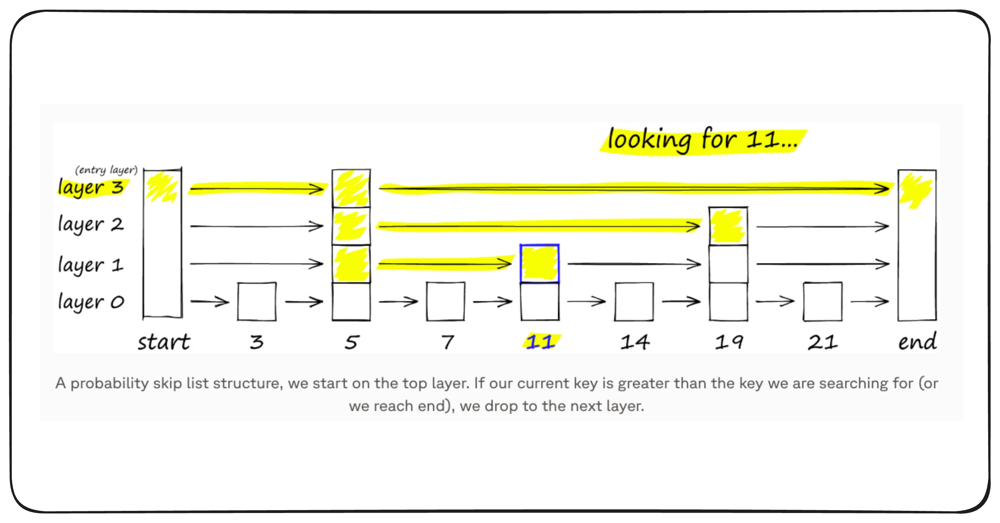

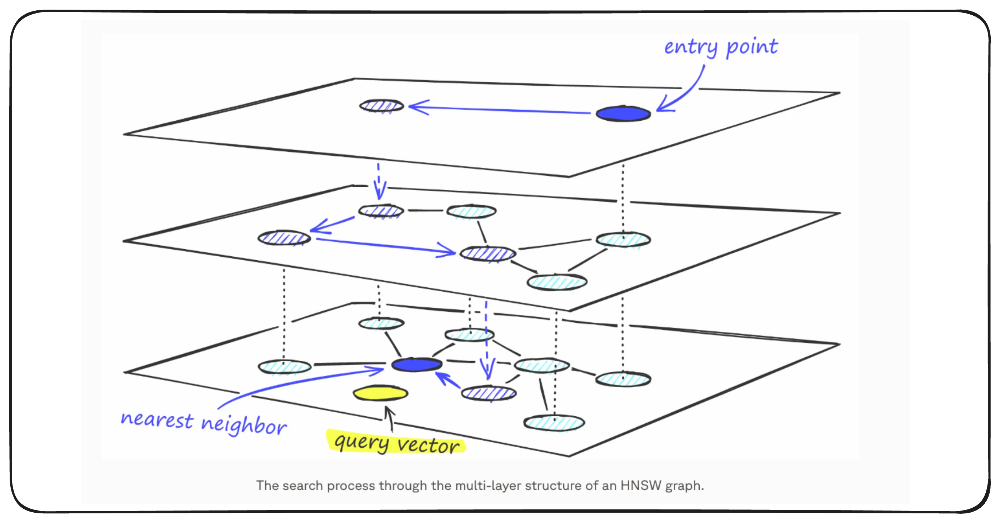

[Reference to HNSW](https://www.pinecone.io/learn/series/faiss/hnsw/)

In [35]:
# Install required libraries with correct versions
!pip install -q langchain langchain-community langchain-huggingface chromadb ragatouille

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 98.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.1/46.1 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 73.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.7/64.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.8/23.8 MB 109.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.5/17.5 MB 138.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 124.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/11.9 MB 150.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 303.3/303.3 kB 33.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.8/51.8 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.0/51.0 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB

In [36]:
from langchain_community.vectorstores import Chroma
from langchain_huggingface import HuggingFaceEmbeddings
from langchain_community.vectorstores.utils import filter_complex_metadata

# Use the BAAI/bge-base-en-v1.5 model - a strong bi-encoder for retrieval
embeddings = HuggingFaceEmbeddings(model_name="BAAI/bge-base-en-v1.5")

print(f"Embedding model loaded: BAAI/bge-base-en-v1.5")
print(f"This is a bi-encoder that processes queries and documents independently")

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/52.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/777 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/366 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Embedding model loaded: BAAI/bge-base-en-v1.5
This is a bi-encoder that processes queries and documents independently


In [37]:
# Prepare documents for ChromaDB
# We'll use the chunks we created earlier
from langchain_core.documents import Document

# Convert our chunks to LangChain Document objects
documents = []
for i, chunk_text in enumerate(chunk_texts[:200]):
    documents.append(
        Document(
            page_content=chunk_text,
            metadata={"chunk_id": i, "source": "huggingface_doc"}
        )
    )

# ChromaDB doesn't support complex metadata, so filter it
docs = filter_complex_metadata(documents)

print(f"Prepared {len(docs)} documents for indexing")

Prepared 200 documents for indexing


In [38]:
# Create ChromaDB vector store with HNSW indexing
# ChromaDB automatically uses HNSW for efficient similarity search
vectorstore = Chroma.from_documents(
    documents=docs,
    embedding=embeddings,
    collection_name="huggingface_docs_advanced"
)

print("Vector store created with HNSW indexing")
print(f"Total documents indexed: {vectorstore._collection.count()}")

Vector store created with HNSW indexing
Total documents indexed: 200


In [39]:
# Create a retriever - this uses the bi-encoder for fast initial search
retriever = vectorstore.as_retriever(
    search_type="similarity",
    search_kwargs={"k": 20}  # Retrieve top 20 candidates initially
)

print("Retriever configured:")
print("  - Search type: similarity (cosine distance)")
print("  - Initial candidates: 20")
print("  - Algorithm: HNSW (logarithmic search time)")

Retriever configured:
  - Search type: similarity (cosine distance)
  - Initial candidates: 20
  - Algorithm: HNSW (logarithmic search time)


---

## **Understanding Bi-Encoders**

The embedding model we're using (`BAAI/bge-base-en-v1.5`) is a **bi-encoder**. Here's what makes it special:

**Bi-Encoder Architecture:**
- **Independent encoding**: Query and documents are encoded separately
- **Pre-computation**: All document embeddings can be computed once and stored
- **Fast search**: At query time, only encode the query and compare to stored vectors
- **Trade-off**: Fast but may miss nuanced semantic relationships

This is why bi-encoders are perfect for **Stage 1: Fast Retrieval** from millions of documents.

---



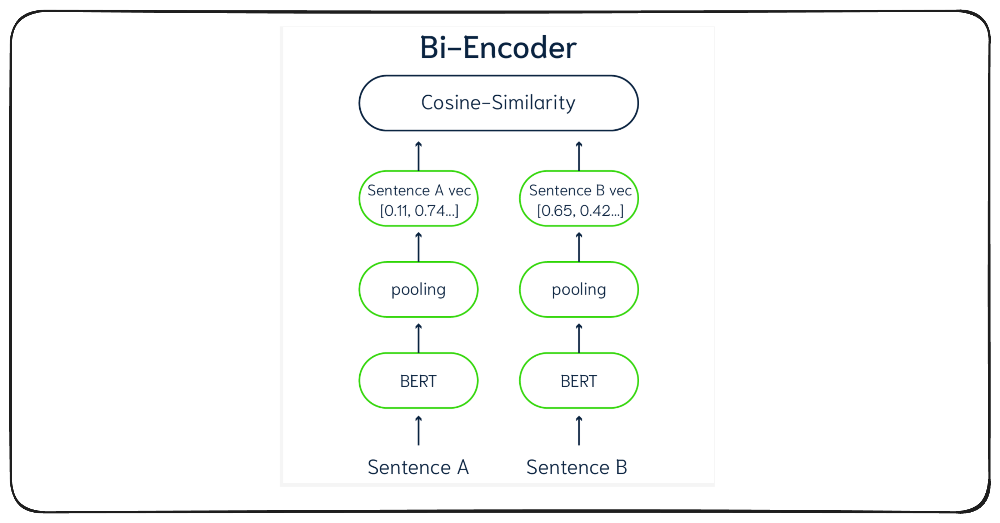

## **Testing HNSW Performance**

Let's compare search performance with HNSW:

In [40]:
import time

# Test query
test_query = "How do I load a pretrained model?"

# Measure search time with HNSW
start_time = time.time()
results = retriever.invoke(test_query)
search_time = time.time() - start_time

print(f"Query: '{test_query}'")
print(f"Search time with HNSW: {search_time*1000:.2f} ms")
print(f"Documents retrieved: {len(results)}\n")

print("=" * 80)
print("Top 3 Results:")
print("=" * 80)
for i, doc in enumerate(results[:3], 1):
    print(f"\nResult {i}:")
    print(f"{doc.page_content[:200]}...")
    print(f"Source: {doc.metadata['source']}, Chunk ID: {doc.metadata['chunk_id']}")

Query: 'How do I load a pretrained model?'
Search time with HNSW: 29.83 ms
Documents retrieved: 20

Top 3 Results:

Result 1:
://github.com/rwightman/pytorch-image-models/blob/master/train.py) to use your dataset.

## How do I train this model?

You can follow the [timm recipe scripts](../scripts) for training a new model af...
Source: huggingface_doc, Chunk ID: 93

Result 2:
 sure dataset loading and model creation are inside the `strategy.scope()` (see [notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/examples/tpu_training-tf.ipynb))
- D...
Source: huggingface_doc, Chunk ID: 61

Result 3:
 summarize with a quick checklist you can follow when you want to get your model ready for TPU training:

- Make sure your code follows the three rules of XLA
- Compile your model with `jit_compile=Tr...
Source: huggingface_doc, Chunk ID: 60


---

## **Challenge 2: The Semantic Gap**

Even with fast search, there's another problem: **the semantic gap** between queries and documents.

### **The Problem**

Users ask short, simple questions:

- *"caffeine effects on teens"*  
- *"best practices for error handling"*  
- *"How do I load a pretrained model?"*  

But the documents containing answers are long and descriptive:

- *"A comprehensive 2022 longitudinal study investigated the impact of daily stimulant consumption patterns among adolescent populations aged 13–17..."*

- *"When implementing production-grade software systems, developers must consider multiple approaches to exception management, including try-catch blocks, error boundaries, and..."*

- *"The AutoModelForSequenceClassification class provides a convenient interface for loading pre-trained transformer models with task-specific heads. To initialize a model, you can use the from_pretrained() method..."*

The query and document use **completely different vocabulary and writing styles**. Their vectors may not be as similar as they should be, leading to **poor retrieval results**.

---

### **The Solution: HyDE (Hypothetical Document Embeddings)**

**HyDE** is a clever technique that bridges the semantic gap. Instead of searching with the user's query directly, you:

1. **Ask an LLM to generate a hypothetical answer** to the question  
2. **Embed this generated answer** (which is now document-like)  
3. **Search using the generated answer's vector**

The LLM generates text that's stylistically similar to the documents in your database—longer, more detailed, using similar vocabulary and structure.

---

### **Implementing HyDE with GPT**

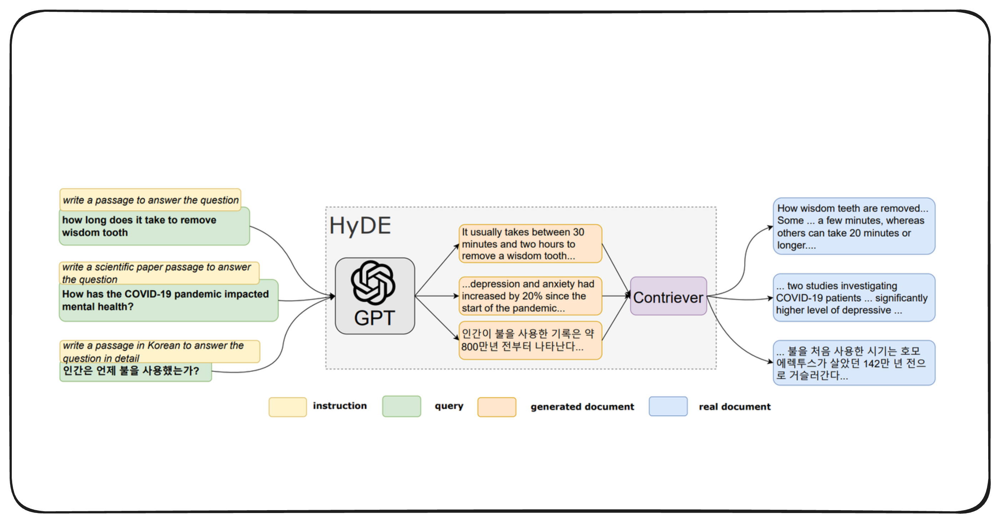

In [41]:
def generate_hypothetical_document(query, open_ai_client):
    """
    Generate a hypothetical document that answers the query.
    This document will be stylistically similar to actual documentation.
    """
    response = open_ai_client.chat.completions.create(
        model="gpt-4o-mini",
        messages=[
            {
                "role": "system",
                "content": "You are a technical documentation writer for Hugging Face. Generate a detailed, technical answer in the style of official documentation."
            },
            {
                "role": "user",
                "content": f"Write a detailed technical answer to this question: {query}"
            }
        ],
        max_tokens=200,
        temperature=0.7
    )

    return response.choices[0].message.content

def hyde_search(query, open_ai_client, retriever):
    """
    Perform HyDE-enhanced search.
    """
    # Generate hypothetical document
    hypothetical_doc = generate_hypothetical_document(query, open_ai_client)

    # Search using the hypothetical document instead of the query
    results = retriever.invoke(hypothetical_doc) #Cosine search give best results

    return results, hypothetical_doc

In [42]:
# Compare standard search vs HyDE
test_query = "How do I load a pretrained model?"

print("=" * 80)
print("COMPARISON: STANDARD SEARCH vs HyDE")
print("=" * 80)
print(f"\nOriginal Query: '{test_query}'\n")

# Standard search
print("-" * 80)
print("STANDARD SEARCH (using original query)")
print("-" * 80)
standard_results = retriever.invoke(test_query)

for i, doc in enumerate(standard_results[:3], 1):
    print(f"\nResult {i}:")
    print(f"{doc.page_content[:150]}...")

# HyDE search
print("\n" + "=" * 80)
print("HyDE SEARCH (using generated hypothetical document)")
print("=" * 80)
hyde_results, hypothetical_doc = hyde_search(test_query, open_ai_client, retriever)

print(f"\nGenerated Hypothetical Document:")
print(f"{hypothetical_doc}\n")
print("-" * 80)

for i, doc in enumerate(hyde_results[:3], 1):
    print(f"\nResult {i}:")
    print(f"{doc.page_content[:150]}...")

COMPARISON: STANDARD SEARCH vs HyDE

Original Query: 'How do I load a pretrained model?'

--------------------------------------------------------------------------------
STANDARD SEARCH (using original query)
--------------------------------------------------------------------------------

Result 1:
://github.com/rwightman/pytorch-image-models/blob/master/train.py) to use your dataset.

## How do I train this model?

You can follow the [timm recip...

Result 2:
 sure dataset loading and model creation are inside the `strategy.scope()` (see [notebook](https://colab.research.google.com/github/huggingface/notebo...

Result 3:
 summarize with a quick checklist you can follow when you want to get your model ready for TPU training:

- Make sure your code follows the three rule...

HyDE SEARCH (using generated hypothetical document)

Generated Hypothetical Document:
# Loading a Pretrained Model with Hugging Face Transformers

Hugging Face's Transformers library provides a straightforward way

**Key Observation:**

The hypothetical document uses technical terminology and formal structure similar to actual documentation. When embedded by the bi-encoder, it produces a vector much closer to real documentation vectors, leading to better retrieval.

**When to Use HyDE:**

- Your documents are formal, long, or technical
- User queries are short and casual  
- There's a significant style mismatch between queries and documents
- Retrieval quality is more important than speed (adds ~1 LLM call latency)

---

## **Challenge 3: Retrieval Precision with Cross-Encoders**

Bi-encoders are fast but sometimes miss nuanced semantic relationships. For the highest precision, we use **cross-encoders** in a second reranking stage.

### **Two-Stage Retrieval Architecture**

Production RAG systems use a **two-stage funnel**:
```
User Query
   ↓
[Stage 1: Bi-Encoder Retrieval]
   - Fast HNSW search
   - Process millions of documents
   - Retrieve top 100-200 candidates
   ↓
[Stage 2: Cross-Encoder Reranking]
   - Deep semantic analysis
   - Process only the candidates
   - Select top 3-5 best matches
   ↓
Send to LLM for generation
```

---

### **Understanding Cross-Encoders**

**Cross-Encoder Architecture:**
- **Joint processing**: Query and document are encoded together
- **Token-level interactions**: Computes attention between every query token and document token
- **Deep understanding**: Captures nuanced semantic relationships
- **Trade-off**: Much slower (can't pre-compute), but far more accurate

**ColBERT v2** is a state-of-the-art cross-encoder that's particularly effective for reranking.

---

### **Setting Up Cross Encoder Reranker**

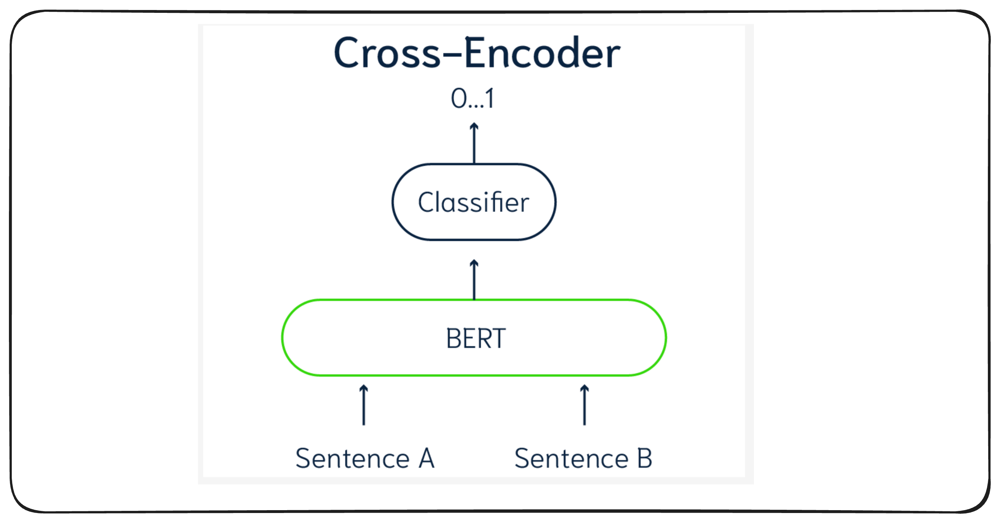

In [43]:
!pip install -q sentence-transformers

In [44]:
from sentence_transformers import CrossEncoder

# Load a cross-encoder model for reranking
reranker = CrossEncoder('cross-encoder/ms-marco-MiniLM-L-6-v2')

print("Cross-encoder reranker loaded")

config.json:   0%|          | 0.00/794 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/132 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

Cross-encoder reranker loaded


In [45]:
from sentence_transformers import CrossEncoder

# Load a cross-encoder model for reranking
reranker = CrossEncoder('cross-encoder/ms-marco-MiniLM-L-6-v2')

print("Cross-encoder reranker loaded")

Cross-encoder reranker loaded


In [46]:
def rerank_documents(query, documents, reranker, k=5):
    """
    Rerank documents using cross-encoder.
    """
    # Create query-document pairs
    pairs = [[query, doc] for doc in documents]

    # Get scores
    scores = reranker.predict(pairs)

    # Sort by scores (higher is better)
    scored_docs = list(zip(documents, scores))
    scored_docs.sort(key=lambda x: x[1], reverse=True)

    # Return top k results in the expected format
    results = []
    for doc, score in scored_docs[:k]:
        results.append({
            'content': doc,
            'score': float(score)
        })

    return results

---

### **Implementing Two-Stage Retrieval**

Let's combine bi-encoder retrieval with cross-encoder reranking:

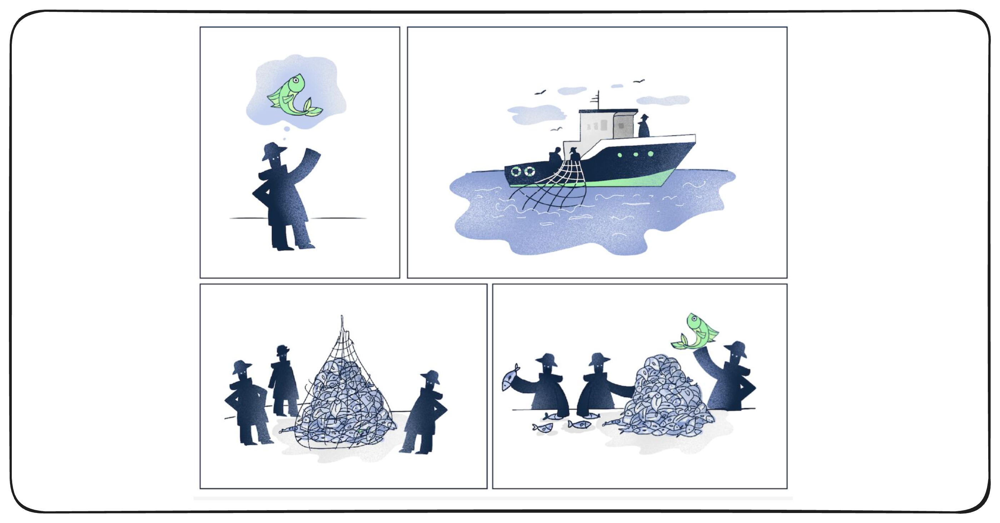

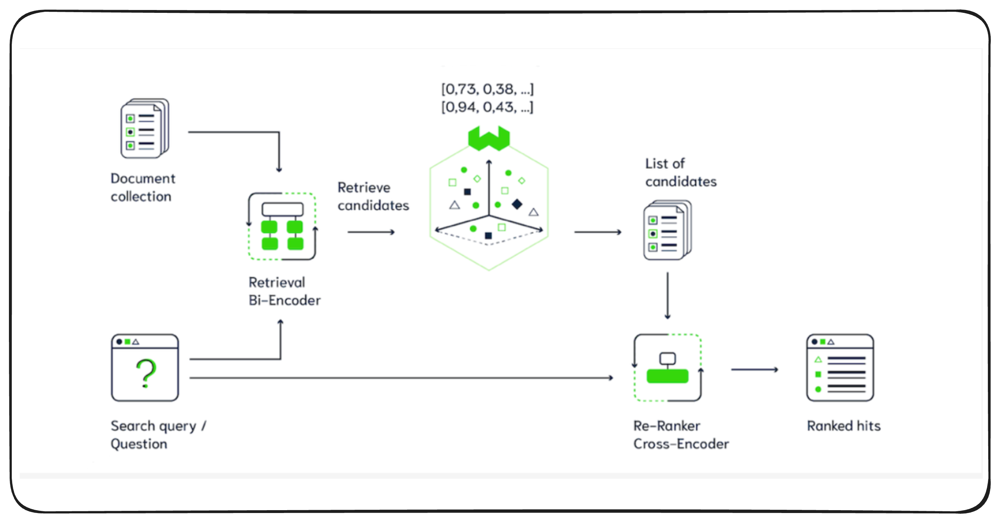

### [Reference](https://weaviate.io/blog/cross-encoders-as-reranker)

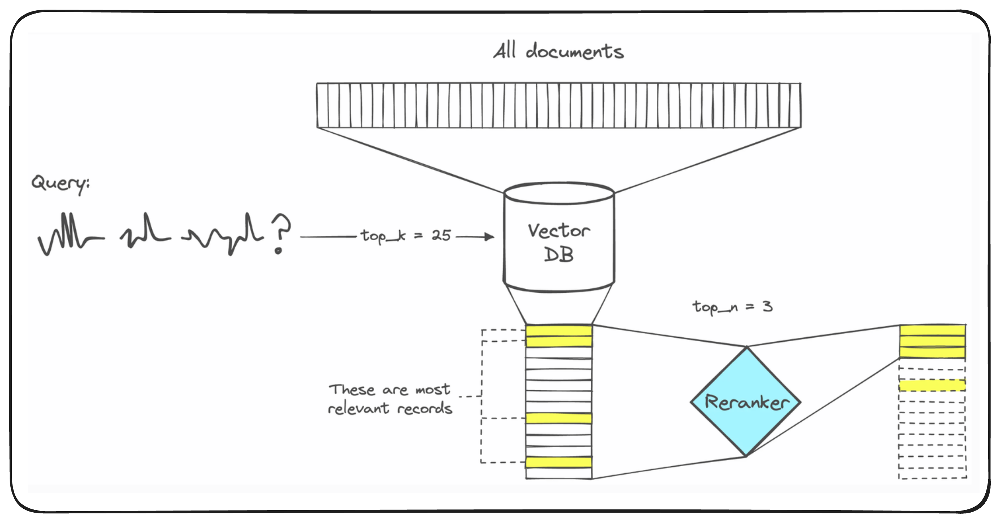

### [Reference](https://www.pinecone.io/learn/series/rag/rerankers/)

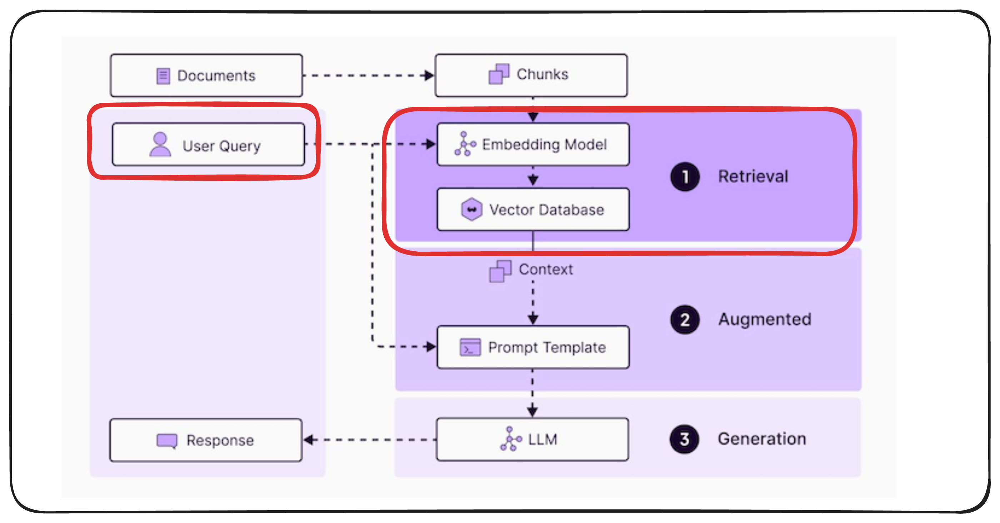

In [47]:
def two_stage_retrieval(query, retriever, reranker, k_initial=20, k_final=5):
    """
    Two-stage retrieval combining bi-encoder speed with cross-encoder precision.

    Args:
        query: User's search query
        retriever: LangChain retriever (uses bi-encoder)
        reranker: ColBERT reranker (cross-encoder)
        k_initial: Number of candidates from Stage 1
        k_final: Number of final results after Stage 2
    """
    print("=" * 80)
    print("TWO-STAGE RETRIEVAL PIPELINE")
    print("=" * 80)
    print(f"Query: '{query}'\n")

    # Stage 1: Fast bi-encoder retrieval
    print(f"Stage 1: Bi-Encoder Retrieval (HNSW search)")
    print(f"  - Searching through all documents...")
    print(f"  - Retrieving top {k_initial} candidates...")

    start_time = time.time()
    initial_results = retriever.invoke(query)
    stage1_time = time.time() - start_time

    print(f"  - Time: {stage1_time*1000:.2f} ms")
    print(f"  - Retrieved: {len(initial_results)} candidates\n")

    # Prepare documents for reranking
    candidate_texts = [doc.page_content for doc in initial_results]

    # Stage 2: Cross-encoder reranking
    print(f"Stage 2: Cross-Encoder Reranking (ColBERT)")
    print(f"  - Analyzing {len(candidate_texts)} candidates...")
    print(f"  - Computing deep token-level interactions...")

    start_time = time.time()
    reranked_results = rerank_documents(
        query=query,
        documents=candidate_texts,
        reranker=reranker,
        k=k_final
    )
    stage2_time = time.time() - start_time

    print(f"  - Time: {stage2_time*1000:.2f} ms")
    print(f"  - Selected: {len(reranked_results)} final results\n")

    total_time = (stage1_time + stage2_time) * 1000
    print(f"Total Pipeline Time: {total_time:.2f} ms")

    return reranked_results, initial_results

# Test the two-stage retrieval
query = "How do I fine-tune a transformer model?"

reranked_results, initial_results = two_stage_retrieval(
    query=query,
    retriever=retriever,
    reranker=reranker,
    k_initial=20,
    k_final=5
)

TWO-STAGE RETRIEVAL PIPELINE
Query: 'How do I fine-tune a transformer model?'

Stage 1: Bi-Encoder Retrieval (HNSW search)
  - Searching through all documents...
  - Retrieving top 20 candidates...
  - Time: 14.77 ms
  - Retrieved: 20 candidates

Stage 2: Cross-Encoder Reranking (ColBERT)
  - Analyzing 20 candidates...
  - Computing deep token-level interactions...
  - Time: 30.10 ms
  - Selected: 5 final results

Total Pipeline Time: 44.87 ms


In [48]:
# Compare results from both stages
print("\n" + "=" * 80)
print("STAGE 1 RESULTS (Bi-Encoder only)")
print("=" * 80)

for i, doc in enumerate(initial_results[:5], 1):
    print(f"\nRank {i}:")
    print(f"{doc.page_content[:200]}...")
    print("-" * 40)

print("\n" + "=" * 80)
print("STAGE 2 RESULTS (After Cross-Encoder Reranking)")
print("=" * 80)

for i, result in enumerate(reranked_results, 1):
    print(f"\nRank {i} (Relevance Score: {result['score']:.4f}):")
    print(f"{result['content'][:200]}...")
    print("-" * 40)


STAGE 1 RESULTS (Bi-Encoder only)

Rank 1:
pu), [AWS Inferentia](https://aws.amazon.com/machine-learning/inferentia/)).
* Pruning: remove model parameters that have little or no impact on the predicted outcome.
* Fusion: merge model layers (sa...
----------------------------------------

Rank 2:
>
  <img src="assets/33_large_language_models/02_t0.png">
</kbd>

You can try T0 [here](https://huggingface.co/bigscience/T0pp). This is the kind of research we need more of!

### Fine-Tune Models

If...
----------------------------------------

Rank 3:
6189), ('white wolf', 0.01739676296710968), ('Eskimo dog', 0.011717947199940681)]
```

Replace the model name with the variant you want to use, e.g. `seresnet152d`. You can find the IDs in the model s...
----------------------------------------

Rank 4:
 course of training. Pretty neat, huh?

## Fine-tuning on CORD

Fine-tuning LayoutLMv3 for token classification on [CORD](https://github.com/clovaai/cord) can be done as follows:

```bash
python

**What Changed?**

Notice how the reranked results often have better semantic alignment with the query. The cross-encoder identified subtle relevance signals that the bi-encoder missed.

**Performance Analysis:**

- **Stage 1 (Bi-Encoder)**: ~10-50ms for millions of documents
- **Stage 2 (Cross-Encoder)**: ~100-200ms for 20 candidates  
- **Total**: ~150-250ms

This is acceptable latency for most applications while providing significantly better results.

---

## **Production-Grade Retrieval: Combining All Techniques**

Let's create a complete production pipeline that combines:
1. **HyDE** for query enhancement
2. **Bi-encoder** with HNSW for fast candidate retrieval  
3. **Cross-encoder** for precise reranking

In [49]:
def production_retrieval_pipeline(
    query,
    client,
    retriever,
    reranker,
    use_hyde=True,
    k_initial=20,
    k_final=5,
    verbose=True
):
    """
    Complete production-grade retrieval pipeline.

    Combines:
    - Optional HyDE for query enhancement
    - Bi-encoder with HNSW for fast search
    - Cross-encoder for precise reranking
    """
    if verbose:
        print("=" * 80)
        print("PRODUCTION RETRIEVAL PIPELINE")
        print("=" * 80)
        print(f"Original Query: '{query}'\n")

    # Step 1: Optional HyDE
    search_query = query
    if use_hyde:
        if verbose:
            print("Step 1: Query Enhancement with HyDE")
            print("-" * 40)
        hypothetical_doc = generate_hypothetical_document(query, client)
        search_query = hypothetical_doc
        if verbose:
            print(f"Generated: {hypothetical_doc[:150]}...\n")
    else:
        if verbose:
            print("Step 1: Using original query (HyDE disabled)\n")

    # Step 2: Bi-encoder retrieval with HNSW
    if verbose:
        print("Step 2: Fast Retrieval (Bi-Encoder + HNSW)")
        print("-" * 40)

    start_time = time.time()
    initial_results = retriever.invoke(search_query)
    stage1_time = time.time() - start_time

    if verbose:
        print(f"Retrieved {len(initial_results)} candidates in {stage1_time*1000:.2f} ms\n")

    # Step 3: Cross-encoder reranking
    if verbose:
        print("Step 3: Precision Reranking (Cross-Encoder)")
        print("-" * 40)

    candidate_texts = [doc.page_content for doc in initial_results]

    start_time = time.time()
    final_results = rerank_documents(
        query=query,
        documents=candidate_texts,
        reranker=reranker,
        k=k_final
    )
    stage2_time = time.time() - start_time

    if verbose:
        print(f"Reranked to top {len(final_results)} in {stage2_time*1000:.2f} ms")
        print(f"Total pipeline time: {(stage1_time + stage2_time)*1000:.2f} ms\n")

    return final_results

# Test the complete pipeline
query = "What are the best practices for model quantization?"

print("Testing with HyDE enabled:")
results_with_hyde = production_retrieval_pipeline(
    query=query,
    client=open_ai_client,
    retriever=retriever,
    reranker=reranker,
    use_hyde=True,
    verbose=True
)

print("\n" + "=" * 80)
print("FINAL RESULTS")
print("=" * 80)

for i, result in enumerate(results_with_hyde, 1):
    print(f"\nRank {i} (Score: {result['score']:.4f}):")
    print(f"{result['content'][:250]}...")
    print("-" * 80)

Testing with HyDE enabled:
PRODUCTION RETRIEVAL PIPELINE
Original Query: 'What are the best practices for model quantization?'

Step 1: Query Enhancement with HyDE
----------------------------------------
Generated: # Best Practices for Model Quantization

Model quantization is a crucial technique in deep learning that reduces the model size and computational requ...

Step 2: Fast Retrieval (Bi-Encoder + HNSW)
----------------------------------------
Retrieved 20 candidates in 19.03 ms

Step 3: Precision Reranking (Cross-Encoder)
----------------------------------------
Reranked to top 5 in 29.64 ms
Total pipeline time: 48.67 ms


FINAL RESULTS

Rank 1 (Score: -2.7574):
pu), [AWS Inferentia](https://aws.amazon.com/machine-learning/inferentia/)).
* Pruning: remove model parameters that have little or no impact on the predicted outcome.
* Fusion: merge model layers (say, convolution and activation).
* Quantization: st...
-------------------------------------------------------------------

---

## **Generation: Completing the RAG Pipeline**

Now that we have high-quality retrieved documents, let's connect them to an LLM for generation. The key is to format the retrieved context clearly and use a prompt that enforces grounding in the provided documents.

---

### **The Generation Function**

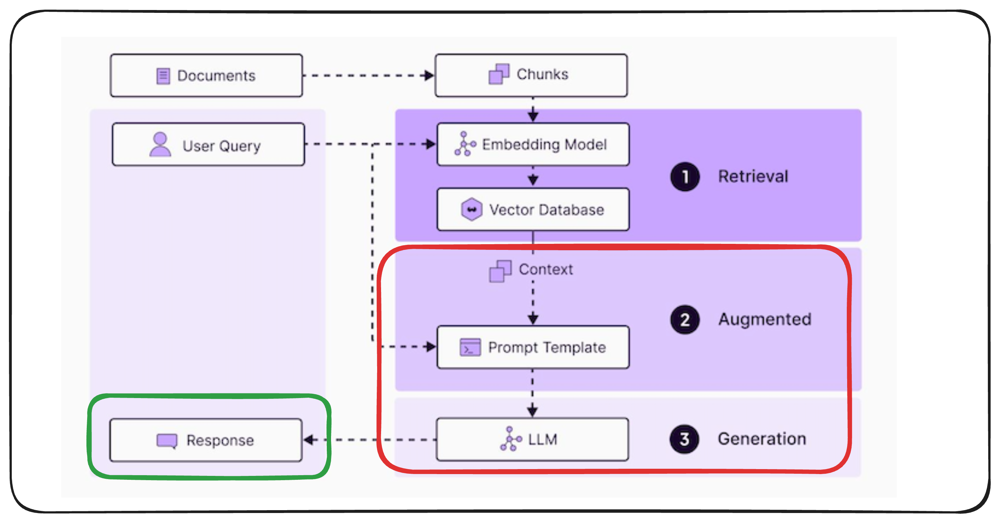

In [50]:
def generate_answer(query, retrieved_results, open_ai_client):
    """
    Generate an answer using retrieved documents and GPT.

    Args:
        query: User's question
        retrieved_results: List of dicts with 'content' and 'score' keys
        client: OpenAI client
    """
    # Format retrieved documents
    documents_text = "\n\n---\n\n".join([
        f"Document {i+1} (Relevance: {result['score']:.3f}):\n{result['content']}"
        for i, result in enumerate(retrieved_results)
    ])

    # Prompt template
    prompt = f"""You are answering questions using ONLY information from the provided documents.

CRITICAL RULES:
1. Every fact in your answer MUST come directly from the documents below
2. If the documents don't contain enough information to answer the question, you MUST say so
3. DO NOT use any knowledge from your training data
4. DO NOT make inferences beyond what is explicitly stated
5. DO NOT fill in gaps with plausible-sounding information

DOCUMENTS:
{documents_text}

QUESTION: {query}

Provide your answer following the rules above."""

    # Generate response
    response = open_ai_client.chat.completions.create(
        model="gpt-4o-mini",
        messages=[
            {"role": "user", "content": prompt}
        ],
        temperature=0.0,  # Use 0 for deterministic, factual responses
        max_tokens=500
    )

    return response.choices[0].message.content

---

### **Complete RAG Pipeline: Retrieval + Generation**

In [51]:
def complete_rag_pipeline(
    query,
    client,
    retriever,
    reranker,
    use_hyde=True,
    k_final=5
):
    """
    End-to-end RAG: Retrieve relevant documents and generate grounded answer.
    """
    print("=" * 80)
    print("COMPLETE RAG PIPELINE")
    print("=" * 80)
    print(f"Question: {query}\n")

    # Step 1: Retrieve and rerank documents
    print("Step 1: Retrieving relevant documents...")
    retrieved_results = production_retrieval_pipeline(
        query=query,
        client=open_ai_client,
        retriever=retriever,
        reranker=reranker,
        use_hyde=use_hyde,
        k_final=k_final,
        verbose=False
    )
    print(f"Retrieved {len(retrieved_results)} relevant documents\n")

    # Step 2: Generate answer
    print("Step 2: Generating grounded answer...")
    answer = generate_answer(query, retrieved_results, client)

    print("\n" + "=" * 80)
    print("ANSWER")
    print("=" * 80)
    print(answer)

    print("\n" + "=" * 80)
    print("SOURCES")
    print("=" * 80)
    for i, result in enumerate(retrieved_results, 1):
        print(f"\nSource {i} (Relevance: {result['score']:.3f}):")
        print(f"{result['content'][:200]}...")

    return answer, retrieved_results

---

### **Testing the Complete RAG System**

In [52]:
# Test the complete pipeline
question = "How do I load a pretrained model in Transformers?"

answer, sources = complete_rag_pipeline(
    query=question,
    client=open_ai_client,
    retriever=retriever,
    reranker=reranker,
    use_hyde=True,
    k_final=3
)

COMPLETE RAG PIPELINE
Question: How do I load a pretrained model in Transformers?

Step 1: Retrieving relevant documents...
Retrieved 3 relevant documents

Step 2: Generating grounded answer...

ANSWER
To load a pretrained model in Transformers, you can use the following code:

```python
from transformers import AutoProcessor, AutoModelForZeroShotObjectDetection

model = AutoModelForZeroShotObjectDetection.from_pretrained(checkpoint)
processor = AutoProcessor.from_pretrained(checkpoint)
```

Make sure to replace `checkpoint` with the specific checkpoint you want to use from the Hugging Face Hub.

SOURCES

Source 1 (Relevance: 4.857):
tasks/zero-sh-obj-detection_2.png" alt="Visualized predictions on NASA image"/>
</div>

## Text-prompted zero-shot object detection by hand

Now that you've seen how to use the zero-shot object detect...

Source 2 (Relevance: -1.672):
pu), [AWS Inferentia](https://aws.amazon.com/machine-learning/inferentia/)).
* Pruning: remove model parameters that have l

In [53]:
# Test with a question that might not be in the documents
question = "What is the weather in San Francisco?"

answer, sources = complete_rag_pipeline(
    query=question,
    client=open_ai_client,
    retriever=retriever,
    reranker=reranker,
    use_hyde=False,
    k_final=3
)

COMPLETE RAG PIPELINE
Question: What is the weather in San Francisco?

Step 1: Retrieving relevant documents...
Retrieved 3 relevant documents

Step 2: Generating grounded answer...

ANSWER
The documents do not contain any information about the weather in San Francisco.

SOURCES

Source 1 (Relevance: -10.872):
   ],
            "bin_edges": [
                -10.206,
                -8.33734,
                -6.46869,
                -4.60004,
                -2.73139,
                -0.86273,
            ...

Source 2 (Relevance: -11.003):
 warm in winter, that's another problem you'll have to deal with. 

In addition, as public awareness grows on climate and social responsibility issues, organizations need to account for their carbon f...

Source 3 (Relevance: -11.091):
 score](https://huggingface.co/metrics/f1), which is the harmonic mean of the precision and recall. It also has a scale of 0.0 to 1.0.

Per type (e.g. `MISC`, `PER`, `LOC`,...):

`precision`: the aver...


---

## **Key Observations**

1. **Grounded Responses**: The LLM only uses information from retrieved documents, avoiding hallucination

2. **Source Attribution**: Users can verify answers by checking the source documents

3. **Honest Uncertainty**: When documents don't contain relevant information, the system acknowledges it

4. **Temperature = 0**: Using zero temperature ensures deterministic, factual responses without creative embellishment

---

## **RAG Pipeline Complete!**

You've built a production-grade RAG system with:

✅ **Document Processing**: Chunking strategies for optimal retrieval  
✅ **Embeddings**: Converting text to semantic vectors  
✅ **Vector Database**: ChromaDB with HNSW indexing for fast search  
✅ **Advanced Retrieval**: HyDE, bi-encoders, and cross-encoder reranking  
✅ **Grounded Generation**: LLM answers strictly based on retrieved context  

This architecture scales from prototypes to production systems handling millions of documents while maintaining speed, accuracy, and reliability.

---

In [54]:
!pip install -q gradio

In [ ]:
import gradio as gr

def rag_interface(query, use_hyde, num_results):
    """
    Gradio interface for RAG system.
    """
    if not query.strip():
        return "Please enter a question.", ""

    try:
        # Run the RAG pipeline
        retrieved_results = production_retrieval_pipeline(
            query=query,
            client=open_ai_client,
            retriever=retriever,
            reranker=reranker,
            use_hyde=use_hyde,
            k_final=num_results,
            verbose=False
        )

        # Generate answer
        answer = generate_answer(query, retrieved_results, open_ai_client)

        # Format retrieved documents
        retrieved_docs_html = ""
        for i, result in enumerate(retrieved_results, 1):
            retrieved_docs_html += f"""
            <div style="border: 1px solid #ddd; padding: 15px; margin: 10px 0; border-radius: 5px; background-color: #f9f9f9;">
                <h4 style="color: #2c3e50; margin-top: 0;">📄 Document {i}</h4>
                <p style="color: #7f8c8d; font-size: 0.9em; margin: 5px 0;">
                    <strong>Relevance Score:</strong> {result['score']:.4f}
                </p>
                <p style="line-height: 1.6; color: #34495e;">
                    {result['content'][:400]}{'...' if len(result['content']) > 400 else ''}
                </p>
            </div>
            """

        # Format final answer
        answer_html = f"""
        <div style="border: 2px solid #3498db; padding: 20px; border-radius: 8px; background-color: #ecf0f1;">
            <h3 style="color: #2980b9; margin-top: 0;">💡 Answer</h3>
            <p style="line-height: 1.8; color: #2c3e50; font-size: 1.05em;">
                {answer}
            </p>
        </div>
        """

        return retrieved_docs_html, answer_html

    except Exception as e:
        error_msg = f"Error: {str(e)}"
        return error_msg, error_msg

# Create Gradio interface
with gr.Blocks(title="RAG System Demo", theme=gr.themes.Soft()) as demo:
    gr.Markdown("""
    # 🚀 Retrieval-Augmented Generation (RAG) System

    Ask questions about the Hugging Face documentation and get grounded, accurate answers!

    This system uses:
    - **HyDE** (optional): Generates hypothetical documents for better retrieval
    - **Bi-Encoder**: Fast HNSW-based vector search
    - **Cross-Encoder**: Precise reranking of candidates
    - **GPT-4**: Grounded generation using retrieved context
    """)

    with gr.Row():
        with gr.Column(scale=2):
            query_input = gr.Textbox(
                label="❓ Your Question",
                placeholder="e.g., How do I load a pretrained model?",
                lines=2
            )

            with gr.Row():
                hyde_checkbox = gr.Checkbox(
                    label="Enable HyDE (better for complex queries)",
                    value=True
                )
                num_results_slider = gr.Slider(
                    minimum=1,
                    maximum=5,
                    value=3,
                    step=1,
                    label="Number of source documents"
                )

            submit_btn = gr.Button("🔍 Search & Answer", variant="primary", size="lg")

    with gr.Row():
        with gr.Column():
            gr.Markdown("## 📚 Retrieved Documents")
            retrieved_output = gr.HTML(label="Source Documents")

    with gr.Row():
        with gr.Column():
            gr.Markdown("## 💬 Generated Answer")
            answer_output = gr.HTML(label="Final Answer")

    # Examples
    gr.Markdown("### 💡 Try these example questions:")
    gr.Examples(
        examples=[
            ["How do I load a pretrained model?", True, 3],
            ["What is tokenization?", True, 3],
            ["How do I fine-tune a transformer model?", True, 4],
            ["What are the different types of attention mechanisms?", False, 3],
        ],
        inputs=[query_input, hyde_checkbox, num_results_slider],
    )

    # Connect the button
    submit_btn.click(
        fn=rag_interface,
        inputs=[query_input, hyde_checkbox, num_results_slider],
        outputs=[retrieved_output, answer_output]
    )

    gr.Markdown("""
    ---
    ### 🎯 How it works:
    1. **Query Enhancement** (optional): HyDE generates a hypothetical answer to improve retrieval
    2. **Fast Retrieval**: Bi-encoder searches millions of documents using HNSW
    3. **Precise Reranking**: Cross-encoder deeply analyzes top candidates
    4. **Grounded Generation**: GPT generates answers using ONLY the retrieved documents
    """)

# Launch the app
demo.launch(share=True, debug=True)

/tmp/ipython-input-1943386155.py:57: DeprecationWarning: The 'theme' parameter in the Blocks constructor will be removed in Gradio 6.0. You will need to pass 'theme' to Blocks.launch() instead.
  with gr.Blocks(title="RAG System Demo", theme=gr.themes.Soft()) as demo:


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://2ff5829efa362473d6.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


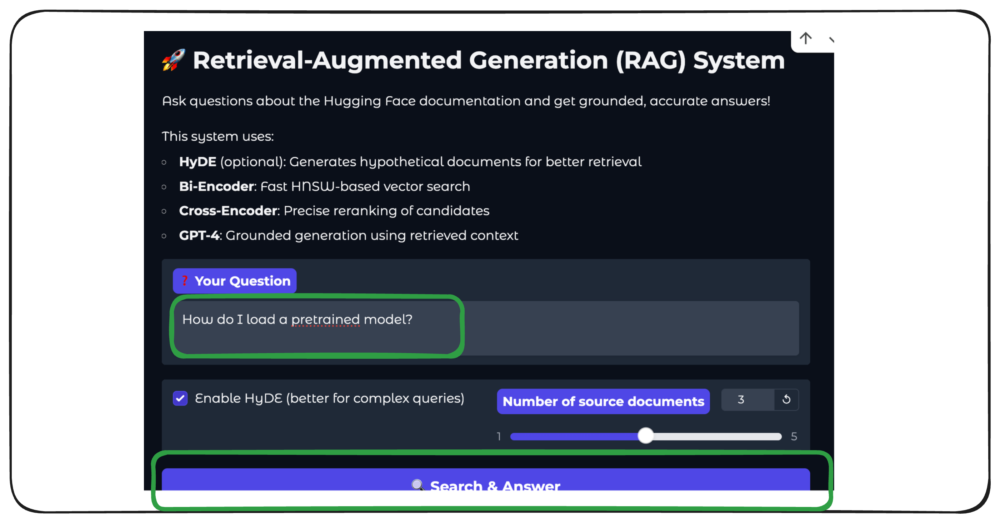

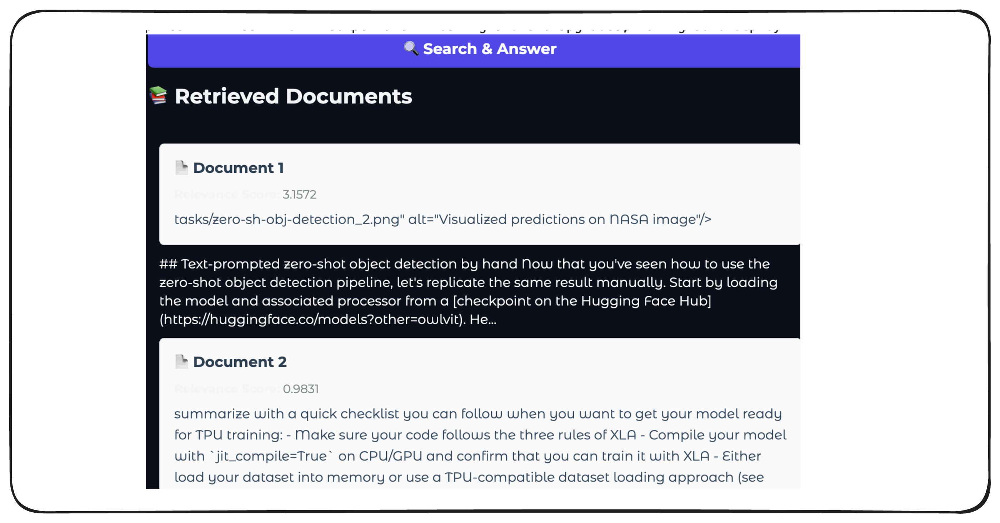

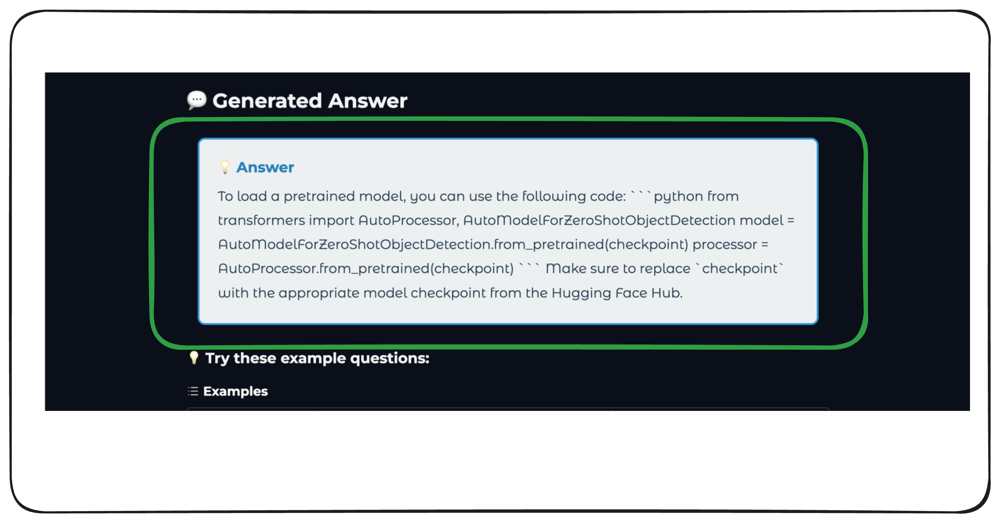

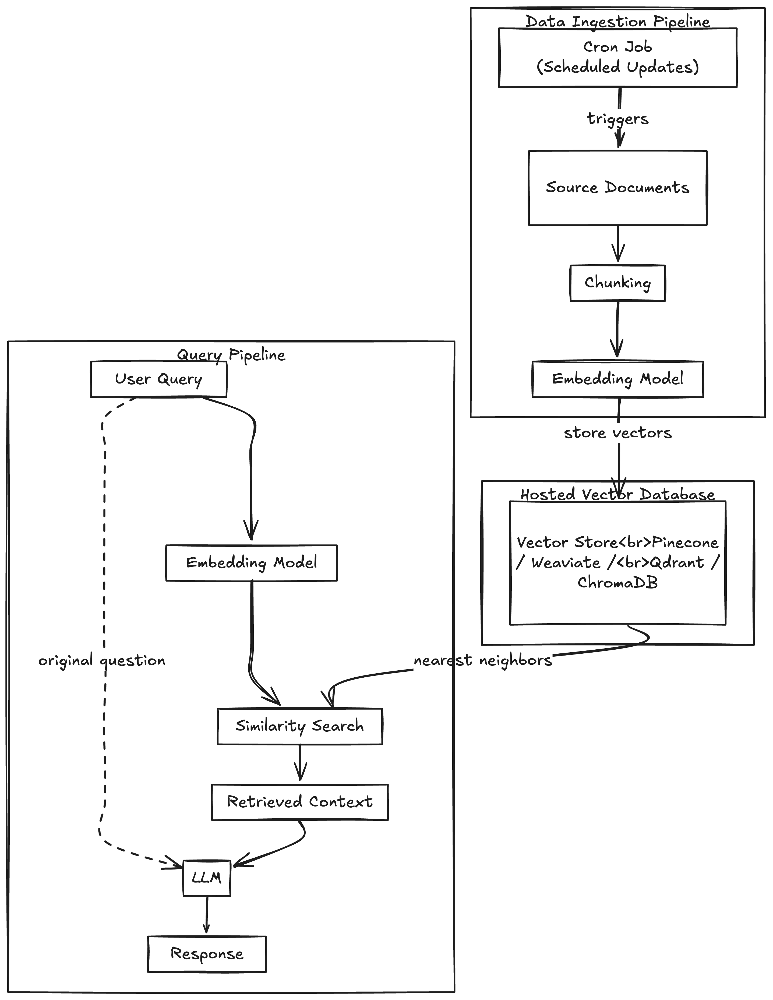